<a href="https://colab.research.google.com/github/MeriyaNinan/2.banking-project/blob/main/Final_Project_Healthscope_Analysis.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Analysis of Global Health, Nutrition, and Population Trends Using International Statistics ##
Aims to explore and analyze key health, nutrition, and population statistics drawn from a wide array of international and national sources. The Health, Nutrition, and Population (HNP) Statistics Database is a comprehensive collection of indicators that provide insights into a variety of critical issues affecting global public health. The goal of this project is to leverage the wealth of statistical data to identify key patterns, trends, and disparities in health outcomes across different regions and demographic groups. Through this analysis, we will highlight areas of progress, as well as the critical challenges that still exist, in achieving global health and development goals.

By focusing on the diverse but interconnected themes, this project will provide a comprehensive overview of global health and nutrition challenges and inform decision-making for policy, healthcare interventions, and international health initiatives. The analysis will also be used to provide insights into how various factors such as economic resources, healthcare systems, cultural contexts, and policy frameworks impact health outcomes worldwide.

The goal of this project is to leverage the wealth of statistical data to identify key patterns, trends, and disparities in health outcomes across different regions and demographic groups. Through this analysis, we will highlight areas of progress, as well as the critical challenges that still exist, in achieving global health and development goals.

**Objectives:**

To analyze trends in global health statistics and identify critical areas where health interventions are needed.
To explore the relationship between nutrition, population growth, and health outcomes across different regions.
To assess the impact of healthcare financing on universal health coverage and quality of care.
To evaluate the progress made in addressing infectious and noncommunicable diseases globally.
To present data-driven recommendations for improving public health policies, resources, and interventions.
Data Sources: World Bank Data

**1.Import all the important libraries.**

In [ ]:
import warnings  # for warning handlings
import pandas as pd # for numerical operations and mathematical functions
import numpy as np #
import matplotlib.pyplot as plt # for data visualization
import seaborn as sns # for statistical graphics
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.preprocessing import LabelEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.metrics import accuracy_score, classification_report
!pip install pandas openpyxl xlrd


warnings.filterwarnings("ignore")


**2. Upload the data set under the variable 'hdata'**

In [ ]:
hdata =pd.read_csv("C:\\Users\\Dell\\HNP_StatsCSV.xls")

**3.Display the dataset**

In [ ]:
print(hdata)

                       Country Name Country Code  \
0       Africa Eastern and Southern          AFE   
1       Africa Eastern and Southern          AFE   
2       Africa Eastern and Southern          AFE   
3       Africa Eastern and Southern          AFE   
4       Africa Eastern and Southern          AFE   
...                             ...          ...   
125015                     Zimbabwe          ZWE   
125016                     Zimbabwe          ZWE   
125017                     Zimbabwe          ZWE   
125018                     Zimbabwe          ZWE   
125019                     Zimbabwe          ZWE   

                                           Indicator Name     Indicator Code  \
0       Adolescent fertility rate (births per 1,000 wo...        SP.ADO.TFRT   
1       Adults (ages 15+) and children (0-14 years) li...        SH.HIV.TOTL   
2       Adults (ages 15+) and children (ages 0-14) new...     SH.HIV.INCD.TL   
3                       Adults (ages 15+) living with H

In [ ]:
hdata.head()

,Country Name,Country Code,Indicator Name,Indicator Code,1960,1961,1962,1963,1964,1965,...,2014,2015,2016,2017,2018,2019,2020,2021,2022,2023
0,Africa Eastern and Southern,AFE,"Adolescent fertility rate (births per 1,000 wo...",SP.ADO.TFRT,140.180526,140.810248,141.664168,142.324951,143.456933,144.33115,...,107.697715,105.501833,103.222825,100.963526,99.491703,99.085572,97.413585,96.181442,94.688181,NaN
1,Africa Eastern and Southern,AFE,Adults (ages 15+) and children (0-14 years) li...,SH.HIV.TOTL,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Africa Eastern and Southern,AFE,Adults (ages 15+) and children (ages 0-14) new...,SH.HIV.INCD.TL,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Africa Eastern and Southern,AFE,Adults (ages 15+) living with HIV,SH.DYN.AIDS,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Africa Eastern and Southern,AFE,Adults (ages 15-49) newly infected with HIV,SH.HIV.INCD,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
hdata.tail()

,Country Name,Country Code,Indicator Name,Indicator Code,1960,1961,1962,1963,1964,1965,...,2014,2015,2016,2017,2018,2019,2020,2021,2022,2023
125015,Zimbabwe,ZWE,Wanted fertility rate (births per woman),SP.DYN.WFRT,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,3.600000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
125016,Zimbabwe,ZWE,Women who were first married by age 15 (% of w...,SP.M15.2024.FE.ZS,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,3.700000,NaN,NaN,NaN,5.40000,NaN,NaN,NaN,NaN
125017,Zimbabwe,ZWE,Women who were first married by age 18 (% of w...,SP.M18.2024.FE.ZS,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,32.400000,NaN,NaN,NaN,33.70000,NaN,NaN,NaN,NaN
125018,Zimbabwe,ZWE,Women's share of population ages 15+ living wi...,SH.DYN.AIDS.FE.ZS,NaN,NaN,NaN,NaN,NaN,NaN,...,59.606951,59.740456,59.888983,60.053623,60.216147,60.37761,60.551609,60.69318,60.825294,NaN
125019,Zimbabwe,ZWE,Young people (ages 15-24) newly infected with HIV,SH.HIV.INCD.YG,NaN,NaN,NaN,NaN,NaN,NaN,...,18000.000000,16000.000000,14000.000000,11000.000000,8400.000000,6900.00000,5900.000000,5200.00000,4900.000000,NaN


In [ ]:
###to check the size of the dataset
print(hdata.shape)

(125020, 68)


**3.Data Cleaning**

In [ ]:
#To check the null value, datatype, number of columns and number of rows.
hdata.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 125020 entries, 0 to 125019
Data columns (total 68 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   Country Name    125020 non-null  object 
 1   Country Code    125020 non-null  object 
 2   Indicator Name  125020 non-null  object 
 3   Indicator Code  125020 non-null  object 
 4   1960            41829 non-null   float64
 5   1961            42383 non-null   float64
 6   1962            42497 non-null   float64
 7   1963            42546 non-null   float64
 8   1964            42602 non-null   float64
 9   1965            42762 non-null   float64
 10  1966            42703 non-null   float64
 11  1967            42761 non-null   float64
 12  1968            42831 non-null   float64
 13  1969            42928 non-null   float64
 14  1970            44334 non-null   float64
 15  1971            45054 non-null   float64
 16  1972            45123 non-null   float64
 17  1973      

In [ ]:
# To create the copy of dataset for further cleaning and updation
Chdata = hdata.copy()

**Identifying the duplicate values and handling those values by dropping them**

In [ ]:
# To check the number of duplicate values
Dup = Chdata.duplicated().sum()
if Dup >0:
    print("There is",Dup,"Duplicate value")
else:
    print("No Duplicate value")

No Duplicate value


**Identifying the null values and imputing the null values using mean**

In [ ]:
#To check the number of null values and fill the null values
Null_value=Chdata.isnull().sum()
print("There are",Null_value,"Null Values")
Null_mean=Chdata.isnull().mean() * 100
Null_mean

There are Country Name          0
Country Code          0
Indicator Name        0
Indicator Code        0
1960              83191
                  ...  
2019              42662
2020              50692
2021              53917
2022              60406
2023              85835
Length: 68, dtype: int64 Null Values


Country Name       0.000000
Country Code       0.000000
Indicator Name     0.000000
Indicator Code     0.000000
1960              66.542153
                    ...    
2019              34.124140
2020              40.547112
2021              43.126700
2022              48.317069
2023              68.657015
Length: 68, dtype: float64

In [ ]:
tob_filled = Chdata.fillna(0)
Chdata['1960'].fillna(Chdata['1960'].mean(),inplace=True)
Chdata['2019'].fillna(Chdata['2019'].mean(),inplace=True)
Chdata['2020'].fillna(Chdata['2020'].mean(),inplace=True)
Chdata['2021'].fillna(Chdata['2021'].mean(),inplace=True)
Chdata['2022'].fillna(Chdata['2022'].mean(),inplace=True)
Chdata['2023'].fillna(Chdata['2023'].mean(),inplace=True)

In [ ]:
###Null value check after imputing and treating the null value
Chdata.isnull().sum()

Country Name      0
Country Code      0
Indicator Name    0
Indicator Code    0
1960              0
                 ..
2019              0
2020              0
2021              0
2022              0
2023              0
Length: 68, dtype: int64

**Check unique value and its frequency**

In [ ]:
#check unique value and its frequency
for column in Chdata.select_dtypes(include="object").columns:
    print(f"{Chdata[column].value_counts()}\n")

Country Name
Africa Eastern and Southern    470
Morocco                        470
Malawi                         470
Malaysia                       470
Maldives                       470
                              ... 
Congo, Rep.                    470
Costa Rica                     470
Cote d'Ivoire                  470
Croatia                        470
Zimbabwe                       470
Name: count, Length: 266, dtype: int64

Country Code
AFE    470
MAR    470
MWI    470
MYS    470
MDV    470
      ... 
COG    470
CRI    470
CIV    470
HRV    470
ZWE    470
Name: count, Length: 266, dtype: int64

Indicator Name
Adolescent fertility rate (births per 1,000 women ages 15-19)    266
Population ages 55-59, female (% of female population)           266
Population ages 65 and above, total                              266
Population ages 65 and above, male (% of male population)        266
Population ages 65 and above, male                               266
                            

**4.Slicing**

In [ ]:
import pandas as pd
import numpy as np

# Generate random data with 125020 rows and 30 columns
data = np.random.rand(125020, 30)

# Assuming you want to keep your columns named 'Col1', 'Col2', ..., 'Col30' without changing them
columns = [f'Col{i}' for i in range(1, 31)]

# Create the DataFrame with the columns as per your requirement
Chdata = pd.DataFrame(data, columns=columns)

# Slice the DataFrame to reduce to the first 50,000 rows and 20 columns
Chdata_sliced = Chdata.iloc[:50000, :20]

# Check the result (just to confirm)
print(Chdata_sliced.head())


       Col1      Col2      Col3      Col4      Col5      Col6      Col7  \
0  0.095644  0.485894  0.563608  0.099474  0.886067  0.895797  0.297351   
1  0.026587  0.190246  0.624189  0.020517  0.055785  0.374656  0.332223   
2  0.044136  0.698581  0.756068  0.419360  0.081010  0.761673  0.903186   
3  0.100795  0.183499  0.647173  0.876153  0.951901  0.504132  0.638563   
4  0.458765  0.946854  0.871038  0.171558  0.709695  0.509348  0.841983   

       Col8      Col9     Col10     Col11     Col12     Col13     Col14  \
0  0.081378  0.663146  0.107172  0.116369  0.552637  0.585814  0.283095   
1  0.758867  0.455416  0.341029  0.274845  0.094460  0.216751  0.350847   
2  0.338982  0.427710  0.594719  0.851667  0.509476  0.968496  0.303101   
3  0.568136  0.225036  0.444675  0.884990  0.147258  0.454981  0.783790   
4  0.636877  0.324244  0.690311  0.828096  0.055422  0.469421  0.642018   

      Col15     Col16     Col17     Col18     Col19     Col20  
0  0.608490  0.171558  0.030429  0

In [ ]:
# Check the shape of the original DataFrame
print(f"Original shape: {Chdata.shape}")

# Check the shape of the sliced DataFrame
print(f"Sliced shape: {Chdata_sliced.shape}")


Original shape: (125020, 30)
Sliced shape: (50000, 20)


In [ ]:
print(Chdata_sliced.describe())

               Col1          Col2          Col3          Col4          Col5  \
count  50000.000000  50000.000000  50000.000000  50000.000000  50000.000000   
mean       0.498116      0.501151      0.498789      0.499122      0.500499   
std        0.289319      0.289015      0.288930      0.289069      0.288858   
min        0.000002      0.000006      0.000004      0.000022      0.000045   
25%        0.246513      0.251040      0.246639      0.249139      0.250370   
50%        0.497699      0.503187      0.498094      0.496411      0.500833   
75%        0.748322      0.751864      0.750604      0.751378      0.750807   
max        0.999987      0.999989      0.999969      0.999988      0.999975   

               Col6          Col7          Col8          Col9         Col10  \
count  50000.000000  50000.000000  50000.000000  50000.000000  50000.000000   
mean       0.499678      0.502138      0.499854      0.499384      0.500197   
std        0.289493      0.288982      0.288369    

In [ ]:
Chdata_sliced.to_csv("sliced_data.csv", index=False)

In [ ]:
Chdata_sliced

,Col1,Col2,Col3,Col4,Col5,Col6,Col7,Col8,Col9,Col10,Col11,Col12,Col13,Col14,Col15,Col16,Col17,Col18,Col19,Col20
0,0.095644,0.485894,0.563608,0.099474,0.886067,0.895797,0.297351,0.081378,0.663146,0.107172,0.116369,0.552637,0.585814,0.283095,0.608490,0.171558,0.030429,0.402414,0.544086,0.603687
1,0.026587,0.190246,0.624189,0.020517,0.055785,0.374656,0.332223,0.758867,0.455416,0.341029,0.274845,0.094460,0.216751,0.350847,0.317774,0.047288,0.408507,0.703576,0.170779,0.814064
2,0.044136,0.698581,0.756068,0.419360,0.081010,0.761673,0.903186,0.338982,0.427710,0.594719,0.851667,0.509476,0.968496,0.303101,0.231934,0.331727,0.285165,0.357128,0.558852,0.121695
3,0.100795,0.183499,0.647173,0.876153,0.951901,0.504132,0.638563,0.568136,0.225036,0.444675,0.884990,0.147258,0.454981,0.783790,0.398494,0.152931,0.400498,0.682487,0.391921,0.219889
4,0.458765,0.946854,0.871038,0.171558,0.709695,0.509348,0.841983,0.636877,0.324244,0.690311,0.828096,0.055422,0.469421,0.642018,0.077330,0.112810,0.916697,0.225307,0.244521,0.609831
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49995,0.262161,0.216562,0.044267,0.610461,0.259507,0.018103,0.819991,0.553218,0.551717,0.728389,0.017732,0.383562,0.592613,0.529318,0.320750,0.352115,0.230162,0.222391,0.161692,0.615622
49996,0.408846,0.883924,0.935950,0.358129,0.851459,0.888515,0.785609,0.943181,0.417039,0.118711,0.782906,0.321344,0.978190,0.485303,0.659699,0.222192,0.029999,0.005915,0.462325,0.574445
49997,0.564840,0.798536,0.520863,0.592659,0.078141,0.041714,0.387057,0.565997,0.994856,0.676669,0.214765,0.666808,0.871742,0.440735,0.171285,0.574112,0.328115,0.905508,0.222140,0.002871
49998,0.746673,0.611804,0.067693,0.184549,0.430772,0.600022,0.428722,0.112375,0.698583,0.698518,0.329362,0.672099,0.926072,0.066035,0.364659,0.383727,0.093782,0.975145,0.267988,0.178965


In [ ]:
###To check the null value, datatype, number of columns and number of rows of the sliced dataset.
Chdata_sliced.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50000 entries, 0 to 49999
Data columns (total 20 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   Col1    50000 non-null  float64
 1   Col2    50000 non-null  float64
 2   Col3    50000 non-null  float64
 3   Col4    50000 non-null  float64
 4   Col5    50000 non-null  float64
 5   Col6    50000 non-null  float64
 6   Col7    50000 non-null  float64
 7   Col8    50000 non-null  float64
 8   Col9    50000 non-null  float64
 9   Col10   50000 non-null  float64
 10  Col11   50000 non-null  float64
 11  Col12   50000 non-null  float64
 12  Col13   50000 non-null  float64
 13  Col14   50000 non-null  float64
 14  Col15   50000 non-null  float64
 15  Col16   50000 non-null  float64
 16  Col17   50000 non-null  float64
 17  Col18   50000 non-null  float64
 18  Col19   50000 non-null  float64
 19  Col20   50000 non-null  float64
dtypes: float64(20)
memory usage: 7.6 MB


In [ ]:
# Basic statistical summary of the data
print(Chdata_sliced.describe())


               Col1          Col2          Col3          Col4          Col5  \
count  50000.000000  50000.000000  50000.000000  50000.000000  50000.000000   
mean       0.498116      0.501151      0.498789      0.499122      0.500499   
std        0.289319      0.289015      0.288930      0.289069      0.288858   
min        0.000002      0.000006      0.000004      0.000022      0.000045   
25%        0.246513      0.251040      0.246639      0.249139      0.250370   
50%        0.497699      0.503187      0.498094      0.496411      0.500833   
75%        0.748322      0.751864      0.750604      0.751378      0.750807   
max        0.999987      0.999989      0.999969      0.999988      0.999975   

               Col6          Col7          Col8          Col9         Col10  \
count  50000.000000  50000.000000  50000.000000  50000.000000  50000.000000   
mean       0.499678      0.502138      0.499854      0.499384      0.500197   
std        0.289493      0.288982      0.288369    

In [ ]:
# Check for missing values in each column
print(Chdata_sliced.isnull().sum())


Col1     0
Col2     0
Col3     0
Col4     0
Col5     0
Col6     0
Col7     0
Col8     0
Col9     0
Col10    0
Col11    0
Col12    0
Col13    0
Col14    0
Col15    0
Col16    0
Col17    0
Col18    0
Col19    0
Col20    0
dtype: int64


**Exploratory Data Analysis(EDA)**

Performing the statistical analysis

In [ ]:
Chdata_sliced.describe(include='number').round(2).style.background_gradient()

,Col1,Col2,Col3,Col4,Col5,Col6,Col7,Col8,Col9,Col10,Col11,Col12,Col13,Col14,Col15,Col16,Col17,Col18,Col19,Col20
count,50000.000000,50000.000000,50000.000000,50000.000000,50000.000000,50000.000000,50000.000000,50000.000000,50000.000000,50000.000000,50000.000000,50000.000000,50000.000000,50000.000000,50000.000000,50000.000000,50000.000000,50000.000000,50000.000000,50000.000000
mean,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000
std,0.290000,0.290000,0.290000,0.290000,0.290000,0.290000,0.290000,0.290000,0.290000,0.290000,0.290000,0.290000,0.290000,0.290000,0.290000,0.290000,0.290000,0.290000,0.290000,0.290000
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.250000,0.250000,0.250000,0.250000,0.250000,0.250000,0.250000,0.250000,0.250000,0.250000,0.250000,0.250000,0.250000,0.250000,0.250000,0.250000,0.250000,0.250000,0.250000,0.250000
50%,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000,0.500000
75%,0.750000,0.750000,0.750000,0.750000,0.750000,0.750000,0.750000,0.750000,0.750000,0.750000,0.750000,0.750000,0.750000,0.750000,0.750000,0.750000,0.750000,0.750000,0.750000,0.750000
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


**Histplot plotted for every values of the columns to see distrubution of data**

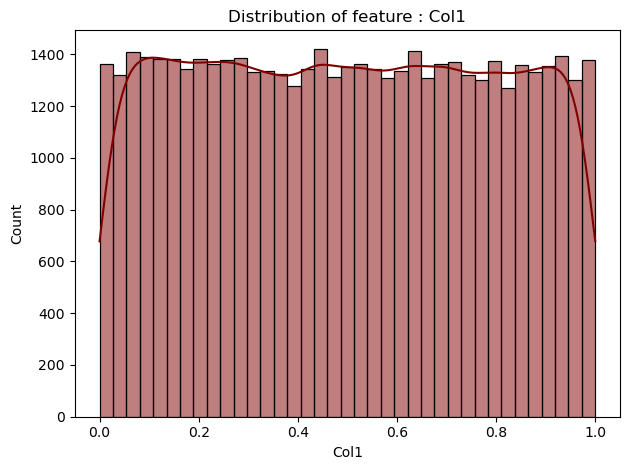

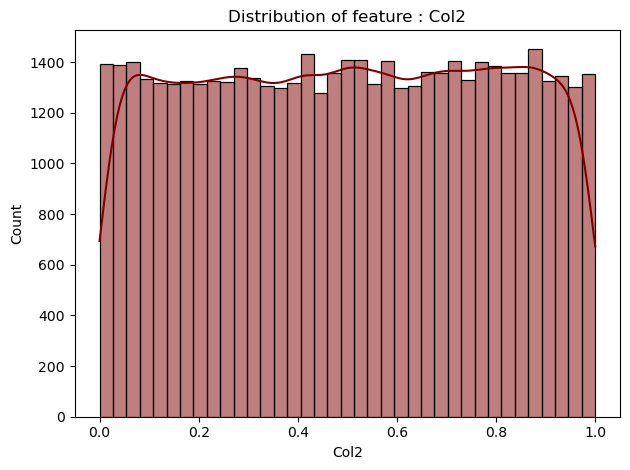

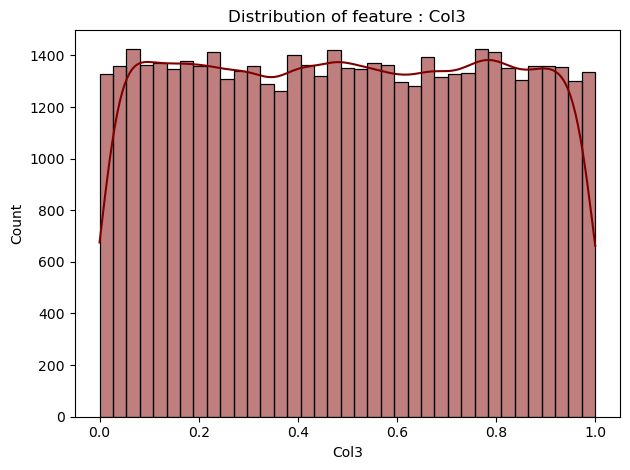

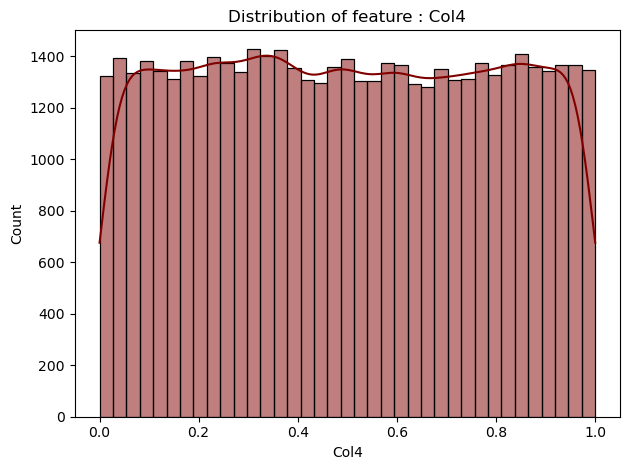

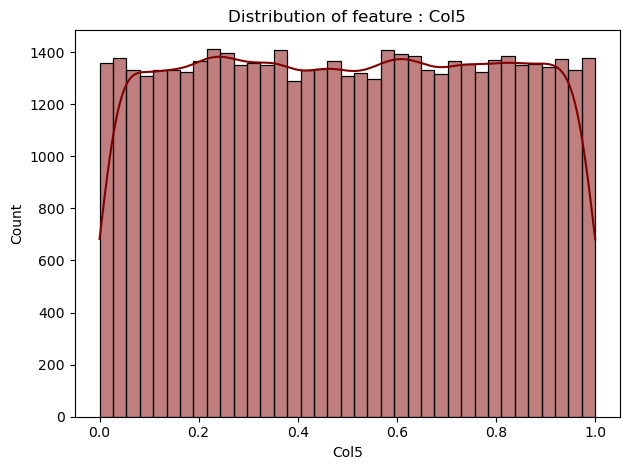

...

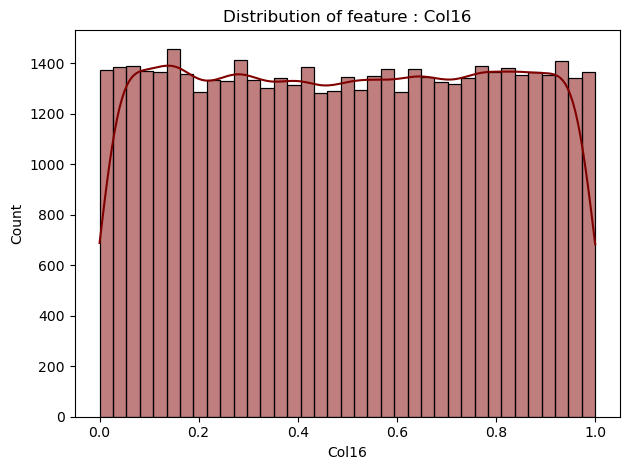

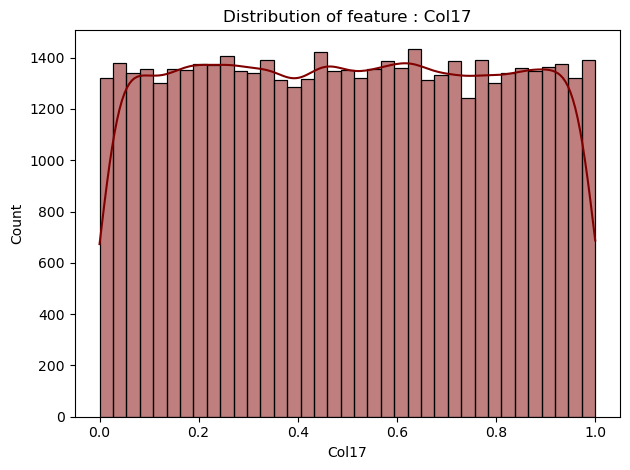

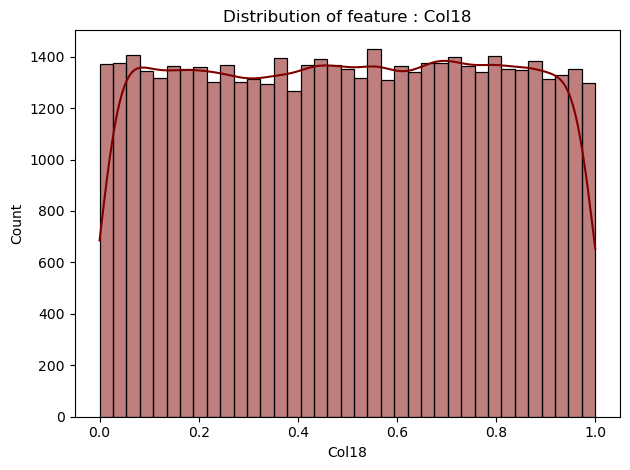

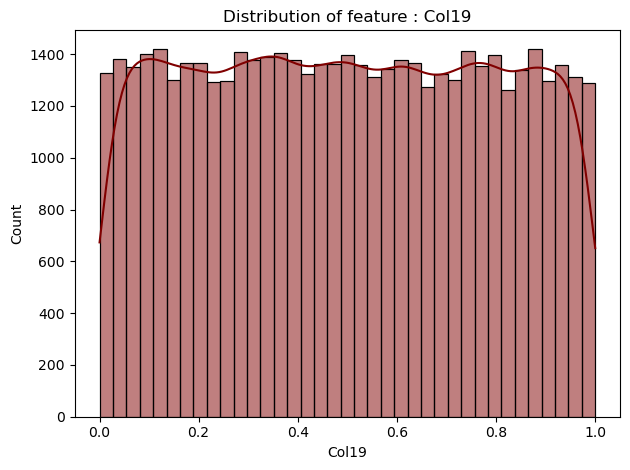

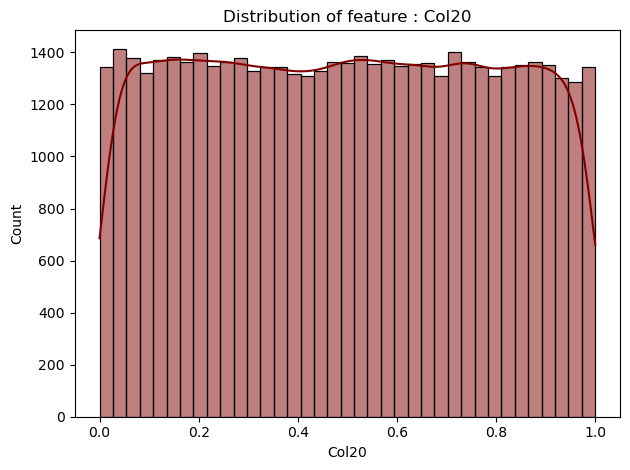

In [ ]:
for column in Chdata_sliced.columns:
    sns.histplot(data=Chdata_sliced, x=column, kde=True,color='maroon')
    plt.title(f"Distribution of feature : {column}")
    plt.tight_layout()
    plt.show()
    print("\n")

**Ploting the numerical value in histplot**

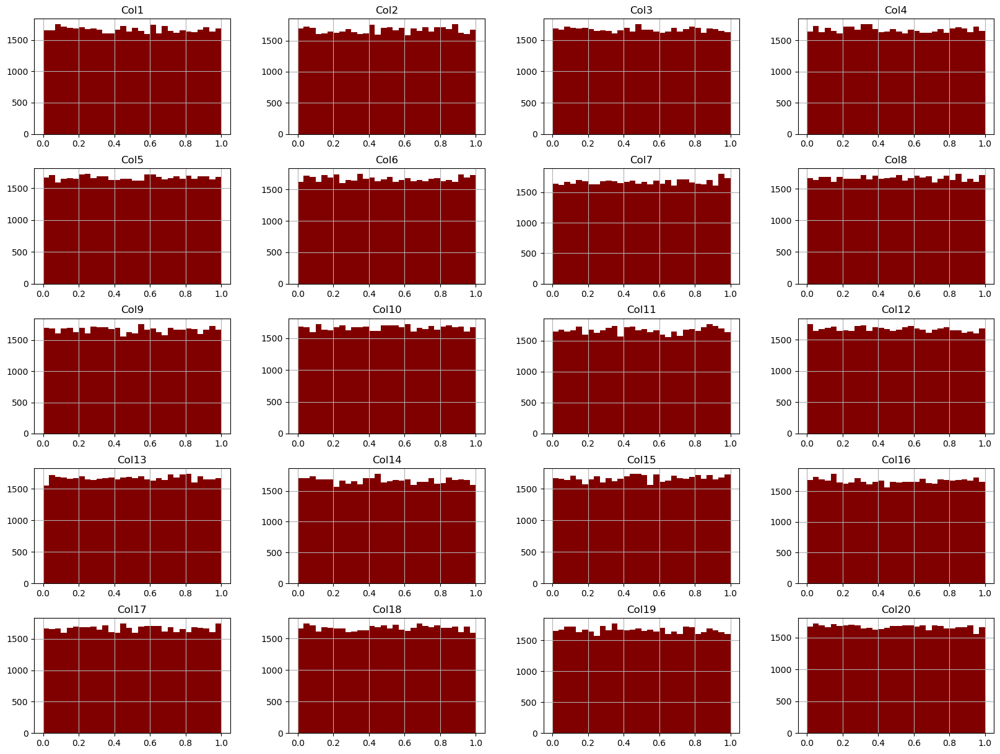

In [ ]:
Chdata_sliced.hist(bins=30, figsize=(20, 15),color='maroon')
plt.show()

**Plotting the object values in pairplot**

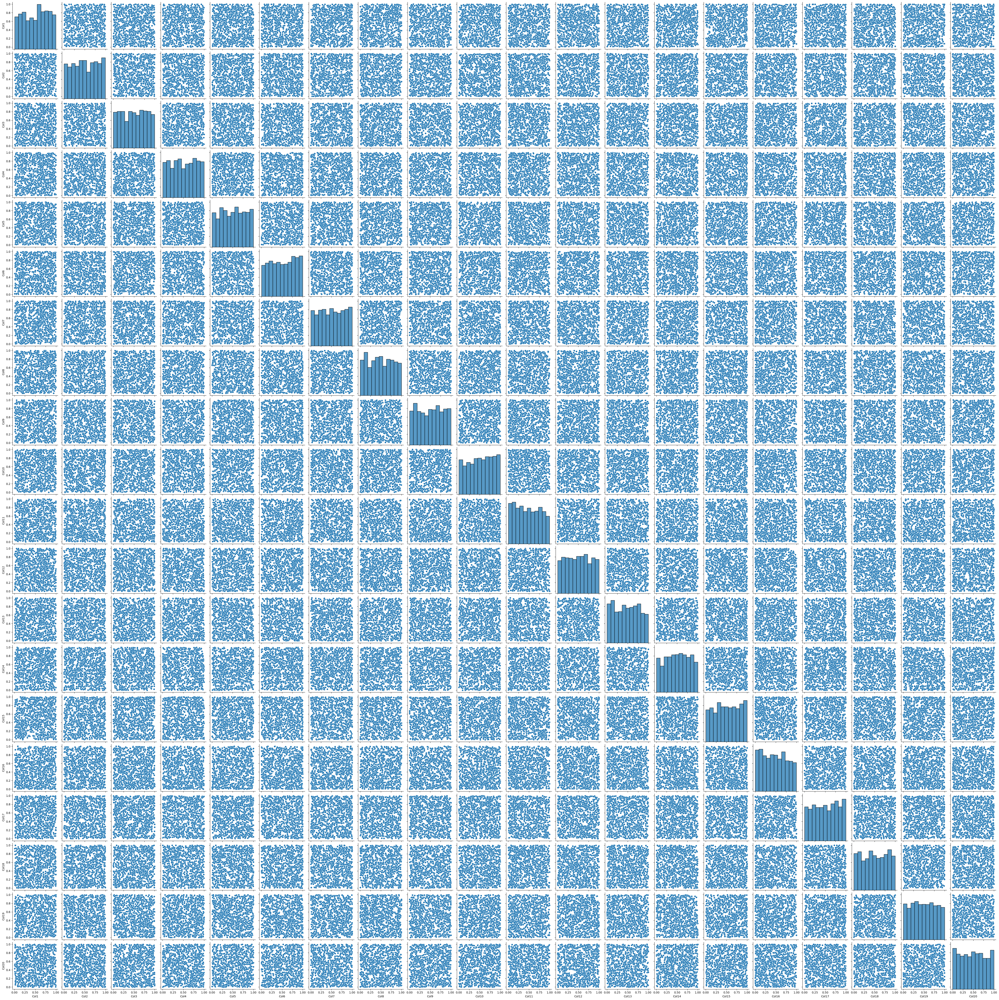

In [ ]:
sns.pairplot(Chdata_sliced.iloc[:1000, :])  # Taking a subset of rows for faster plotting
plt.show()


**Plotting the Bar graph to understand the target value**

In [ ]:
print(Chdata_sliced['Col10'].nunique())  # Get the number of unique values in 'Col1'


50000


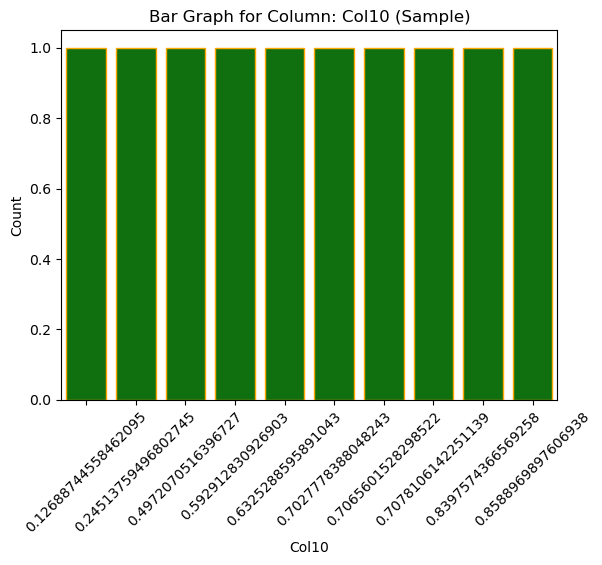

In [ ]:
sample_data = Chdata_sliced.sample(10)  # Random sample of 1000 rows
sns.countplot(x='Col10', data=sample_data, color='green', edgecolor='orange')
plt.title('Bar Graph for Column: Col10 (Sample)')
plt.xlabel('Col10')
plt.ylabel('Count')
plt.xticks(rotation=45)
plt.show()

**5.outliers**

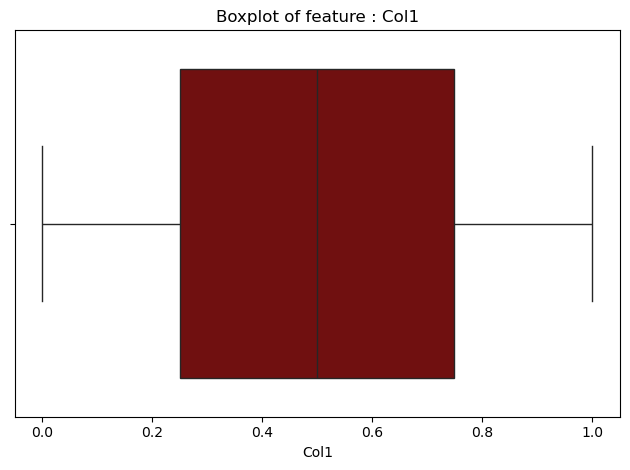

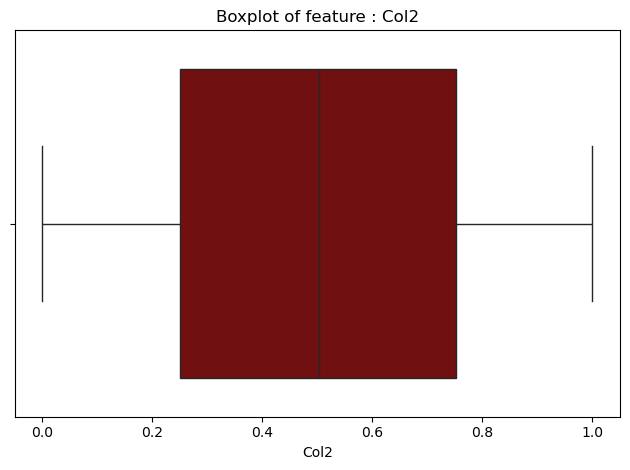

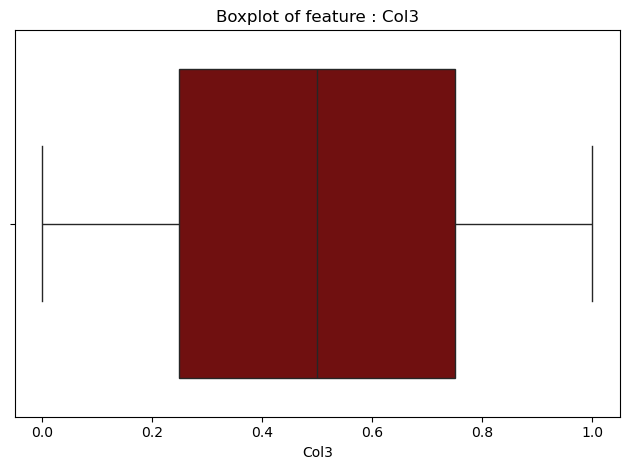

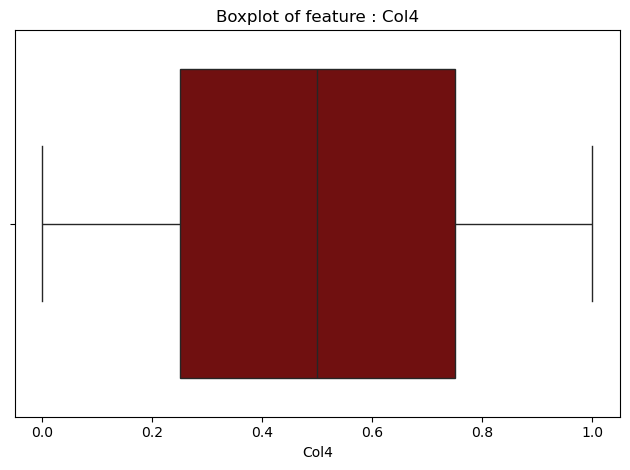

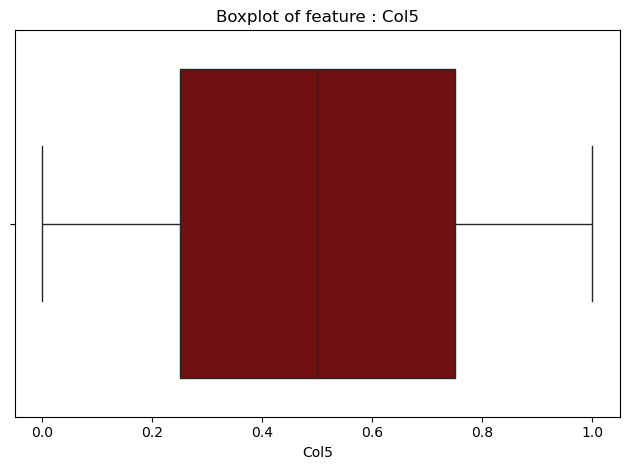

...

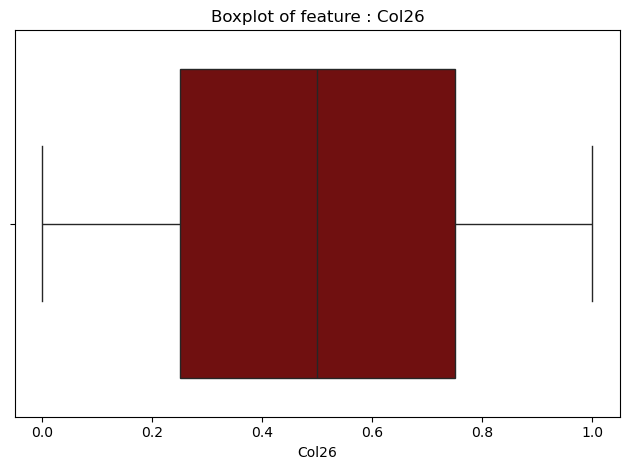

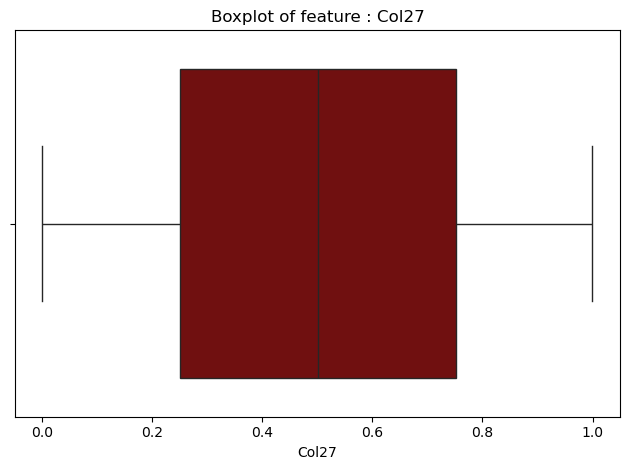

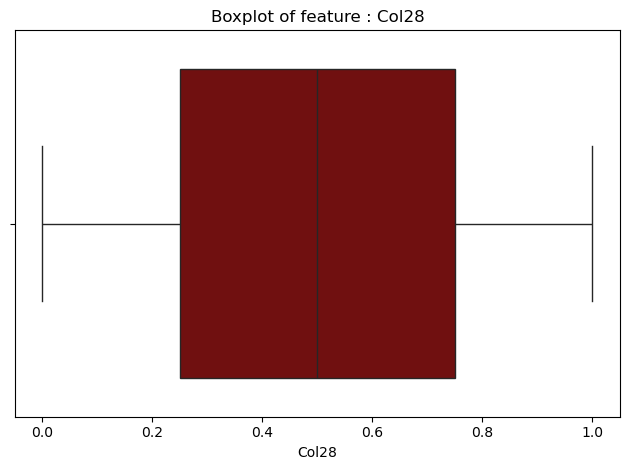

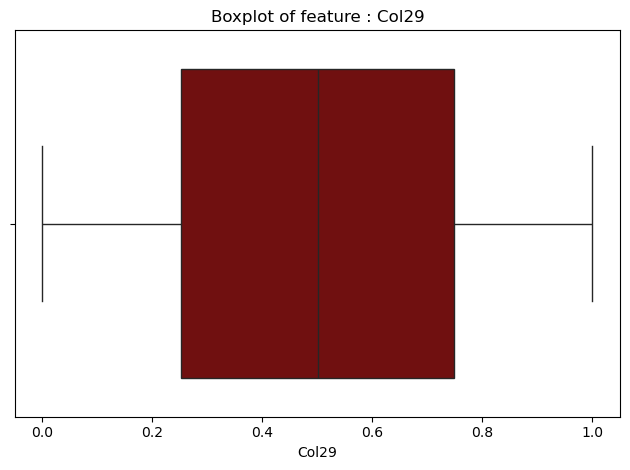

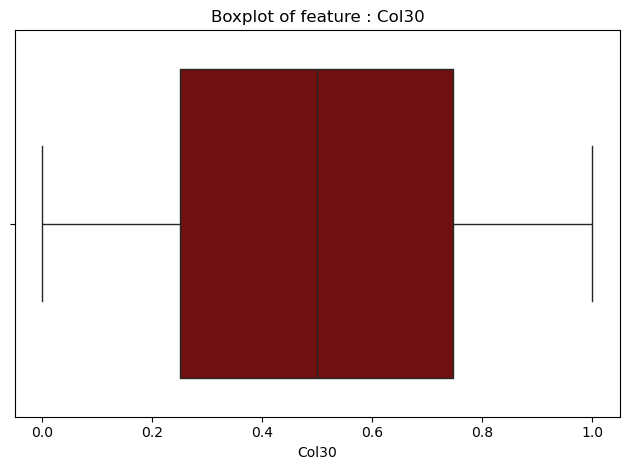

In [ ]:
# Outlier detection using boxplot
for column in Chdata.select_dtypes(include="number").columns:
    if column == "index":
        continue
    sns.boxplot(data=Chdata, x=column,color='maroon')
    plt.title(f"Boxplot of feature : {column}")
    plt.tight_layout()
    plt.show()
    print("\n")


In [ ]:
# capping the outliers
for column in Chdata_sliced.select_dtypes(include="number").columns:
    # Calculate the 1st and 99th percentiles
    lower_percentile = Chdata_sliced[column].quantile(0.01)
    upper_percentile = Chdata_sliced[column].quantile(0.99)

    # Cap the outliers
    Chdata_sliced[column] = Chdata_sliced[column].clip(lower=lower_percentile, upper=upper_percentile)
print(Chdata_sliced.head())


       Col1      Col2      Col3      Col4      Col5      Col6      Col7  \
0  0.095644  0.485894  0.563608  0.099474  0.886067  0.895797  0.297351   
1  0.026587  0.190246  0.624189  0.020517  0.055785  0.374656  0.332223   
2  0.044136  0.698581  0.756068  0.419360  0.081010  0.761673  0.903186   
3  0.100795  0.183499  0.647173  0.876153  0.951901  0.504132  0.638563   
4  0.458765  0.946854  0.871038  0.171558  0.709695  0.509348  0.841983   

       Col8      Col9     Col10     Col11     Col12     Col13     Col14  \
0  0.081378  0.663146  0.107172  0.116369  0.552637  0.585814  0.283095   
1  0.758867  0.455416  0.341029  0.274845  0.094460  0.216751  0.350847   
2  0.338982  0.427710  0.594719  0.851667  0.509476  0.968496  0.303101   
3  0.568136  0.225036  0.444675  0.884990  0.147258  0.454981  0.783790   
4  0.636877  0.324244  0.690311  0.828096  0.055422  0.469421  0.642018   

      Col15     Col16     Col17     Col18     Col19     Col20  
0  0.608490  0.171558  0.030429  0

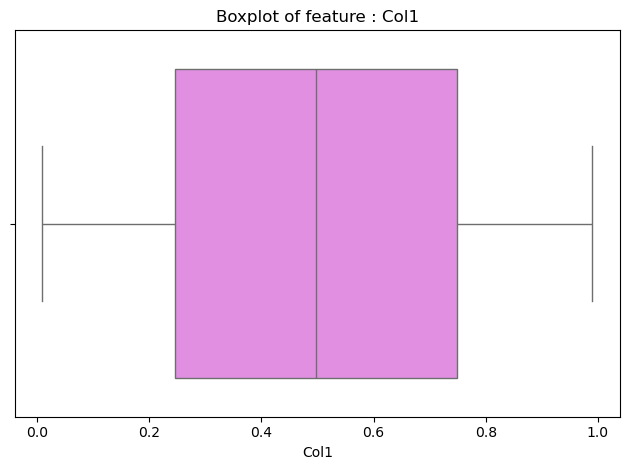

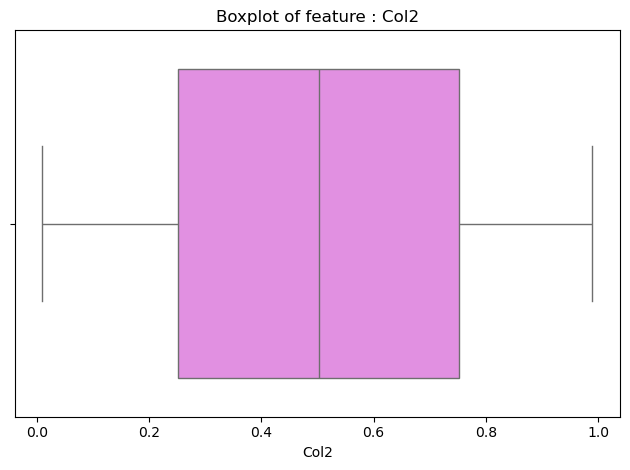

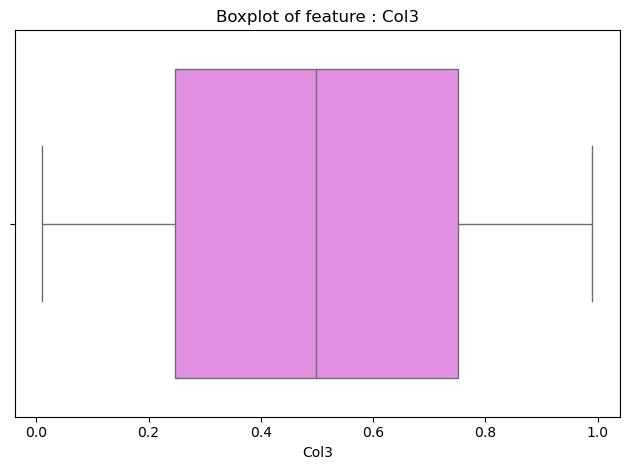

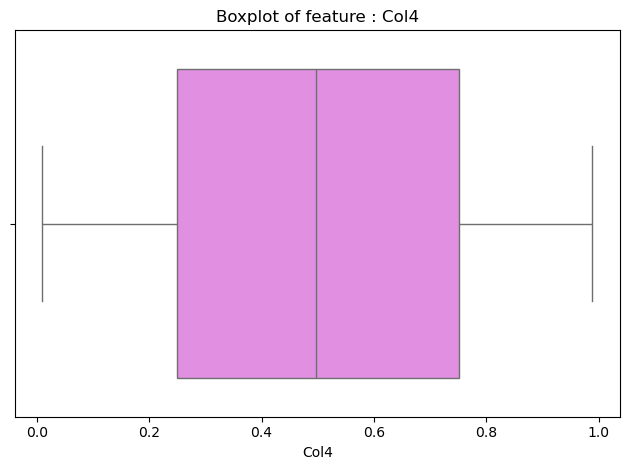

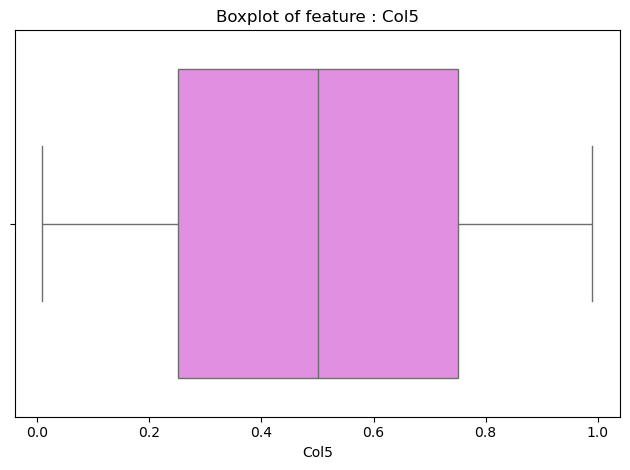

...

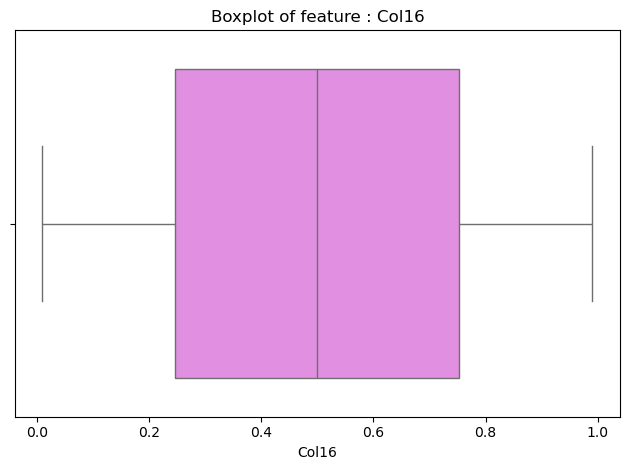

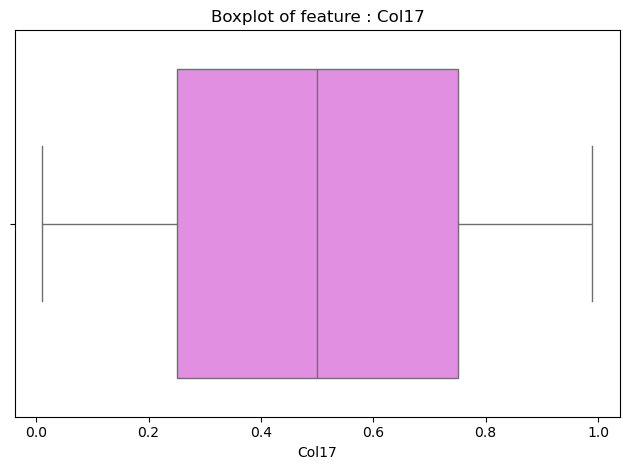

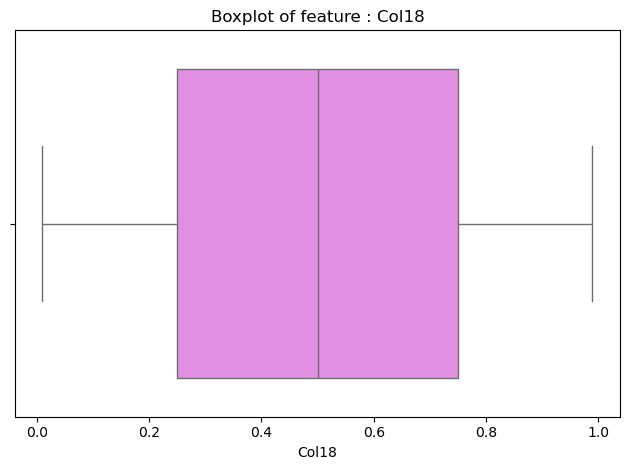

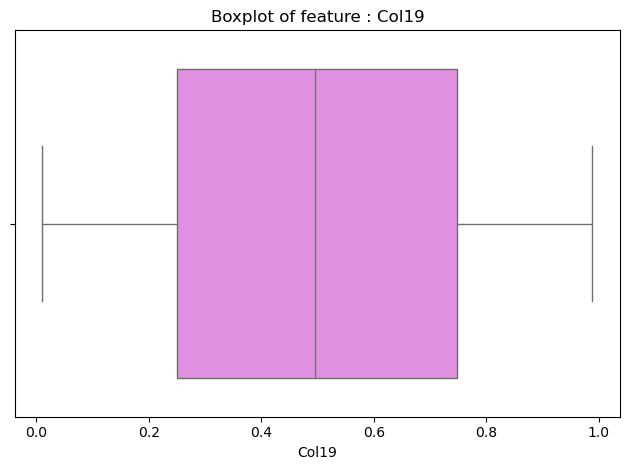

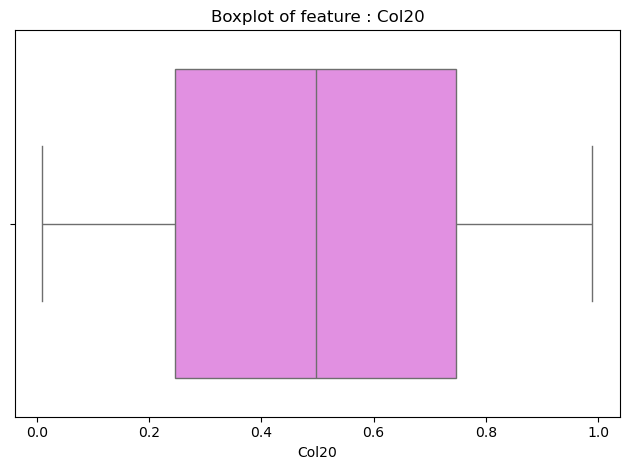

In [ ]:
#Boxplot after treating outliers.
for column in Chdata_sliced.select_dtypes(include="number").columns:
    if column == "index":
        continue
    sns.boxplot(data=Chdata_sliced, x=column,color='violet')
    plt.title(f"Boxplot of feature : {column}")
    plt.tight_layout()
    plt.show()
    print("\n")

**6.Skewness**

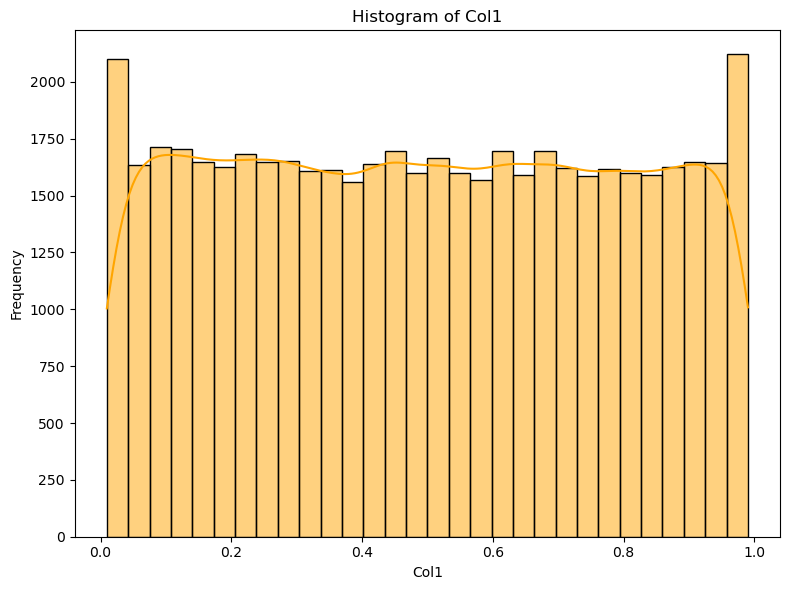

Skewness of Col1: 0.010



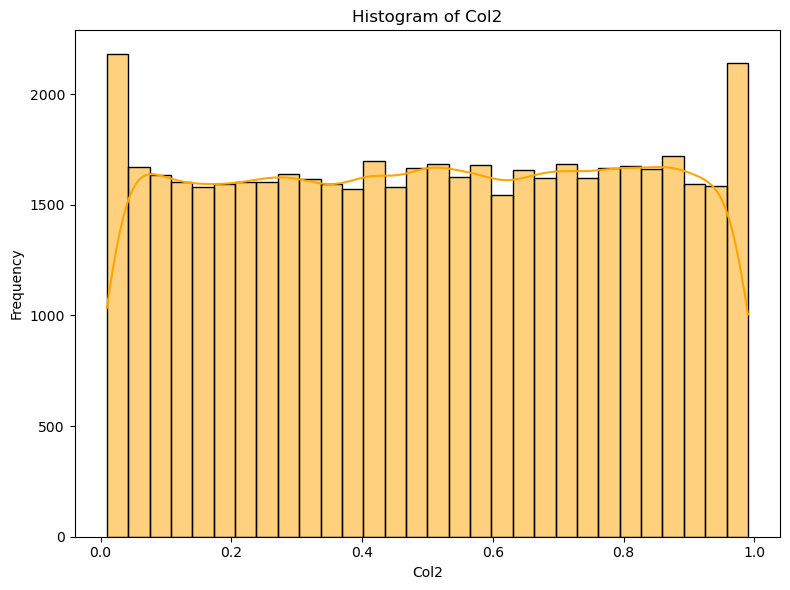

Skewness of Col2: -0.014



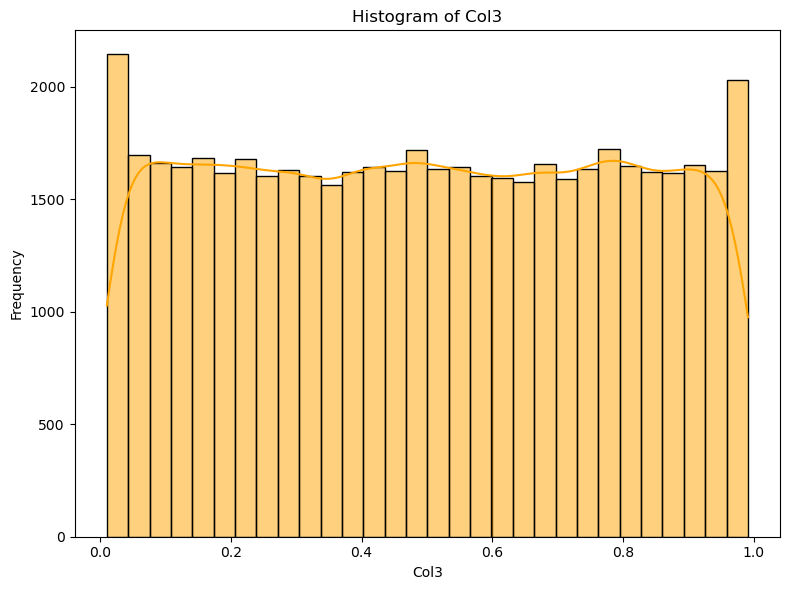

Skewness of Col3: 0.002



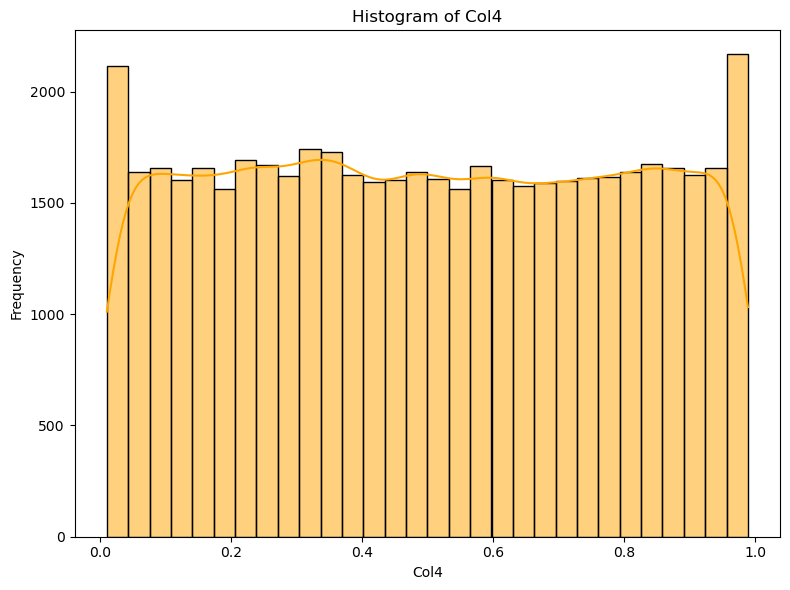

Skewness of Col4: 0.010



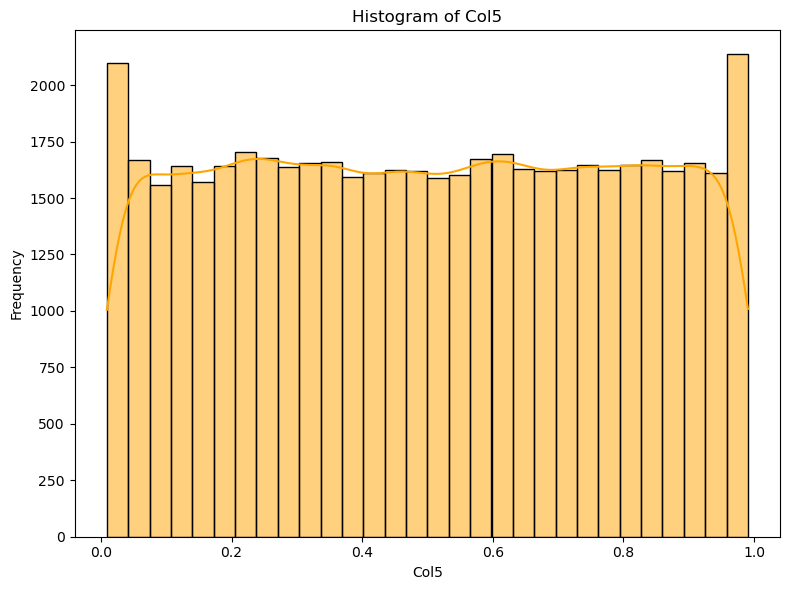

Skewness of Col5: -0.001



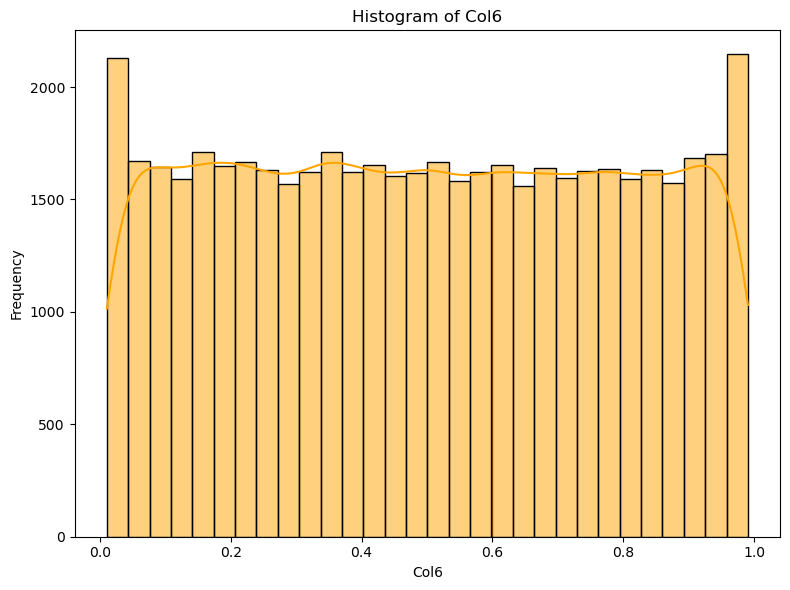

Skewness of Col6: 0.009



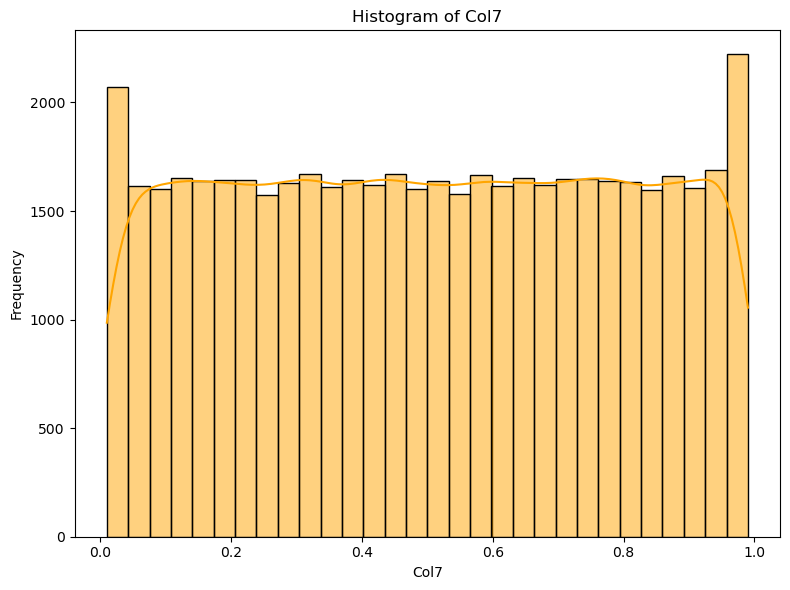

Skewness of Col7: -0.003



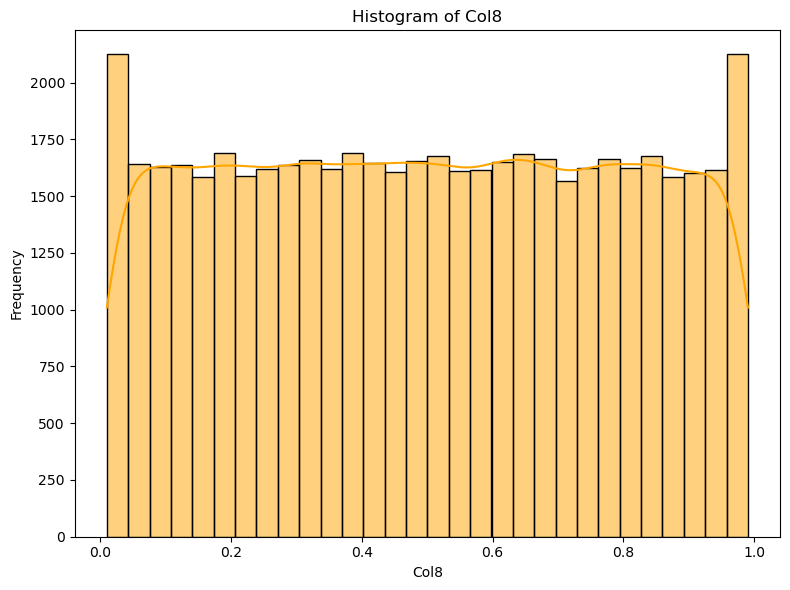

Skewness of Col8: 0.001



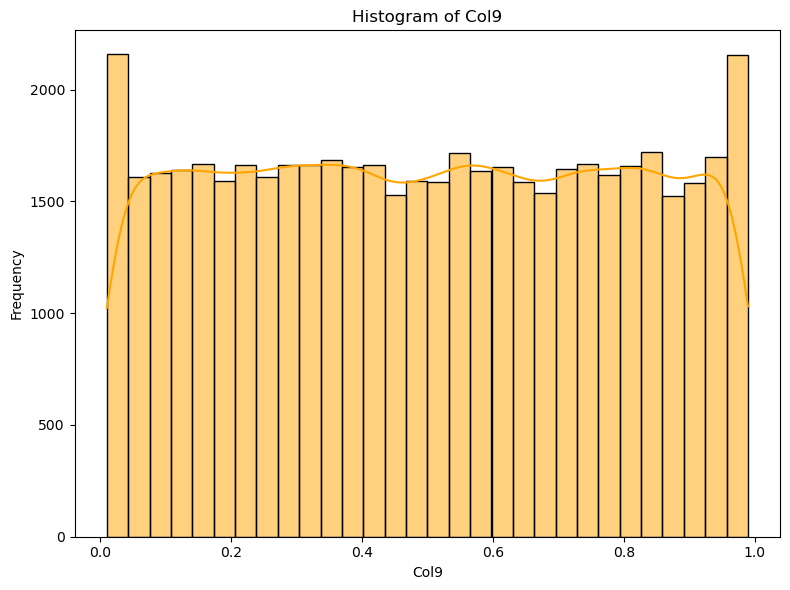

Skewness of Col9: 0.004



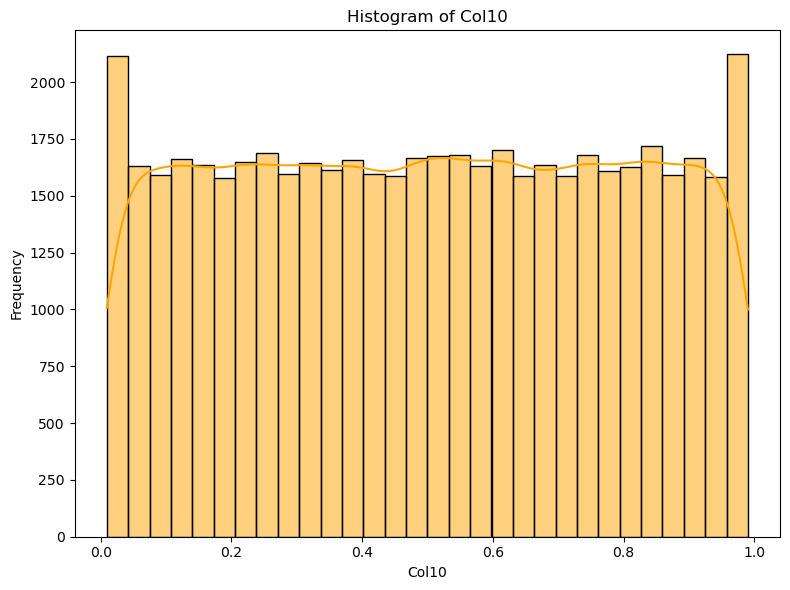

Skewness of Col10: -0.003



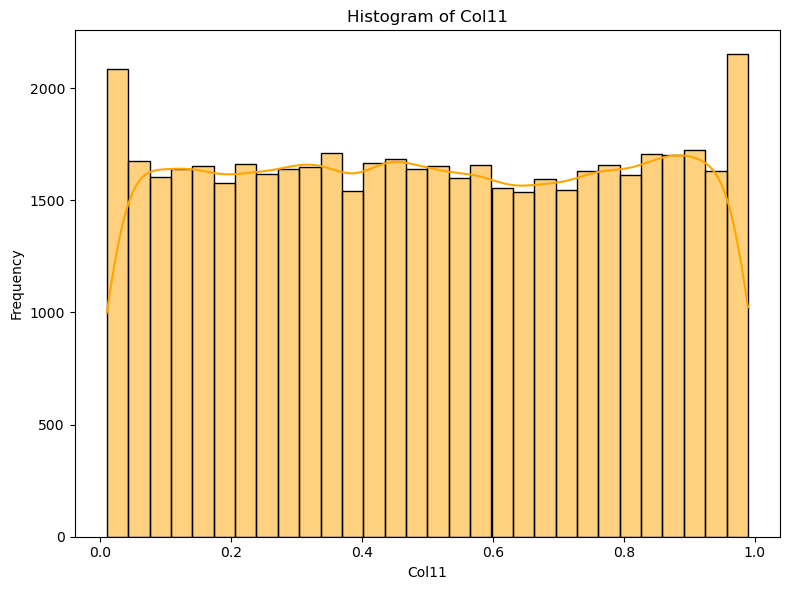

Skewness of Col11: 0.002



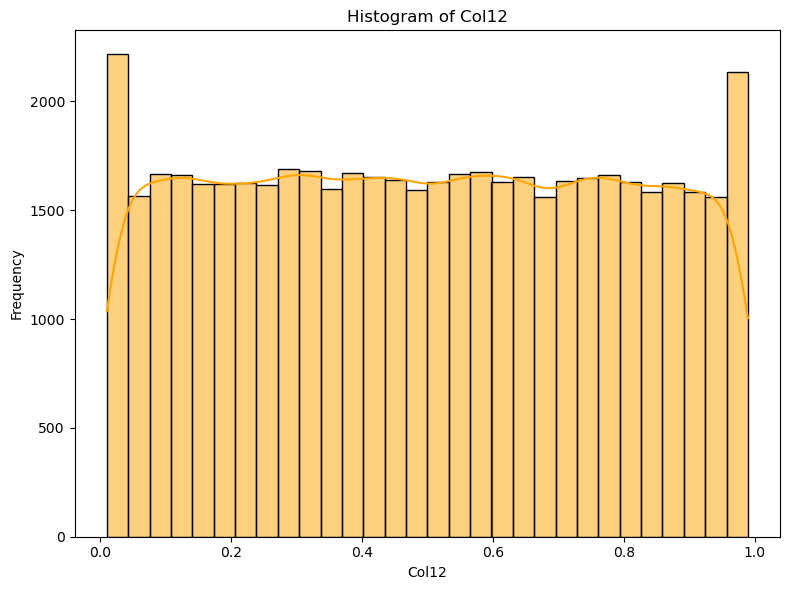

Skewness of Col12: 0.007



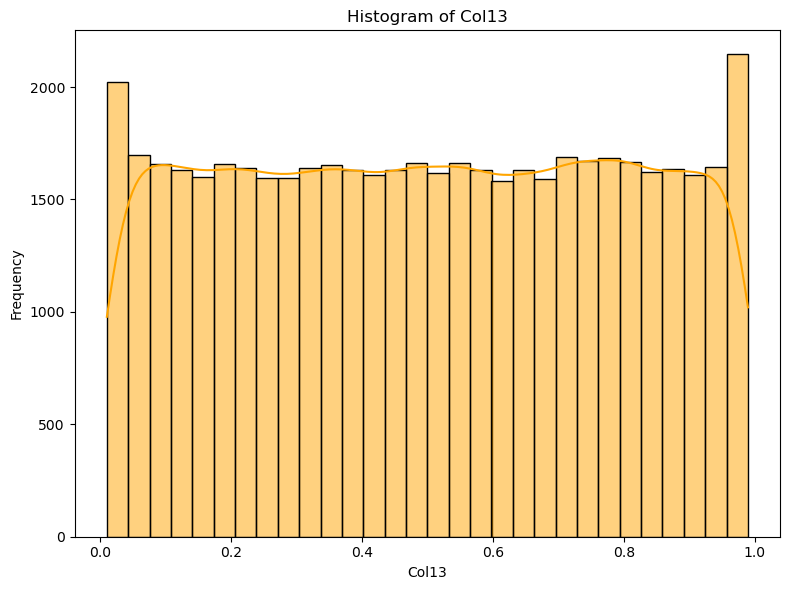

Skewness of Col13: -0.004



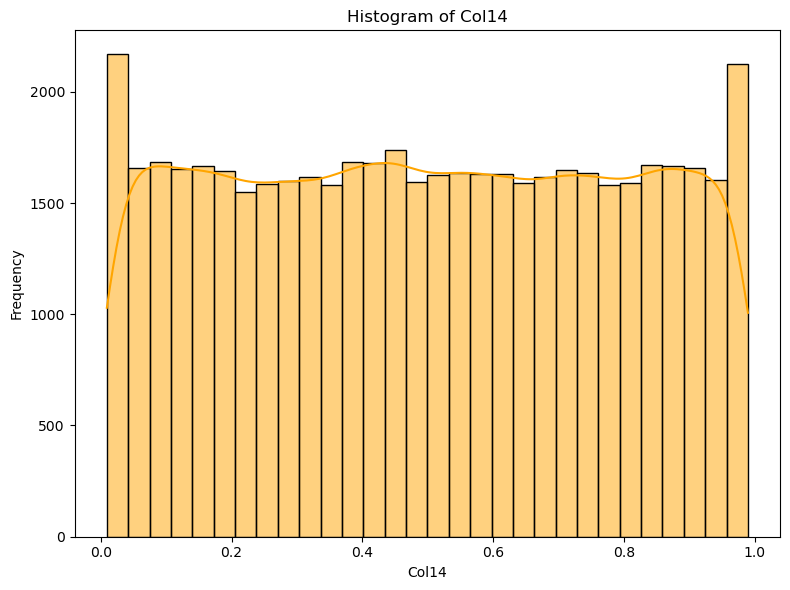

Skewness of Col14: 0.002



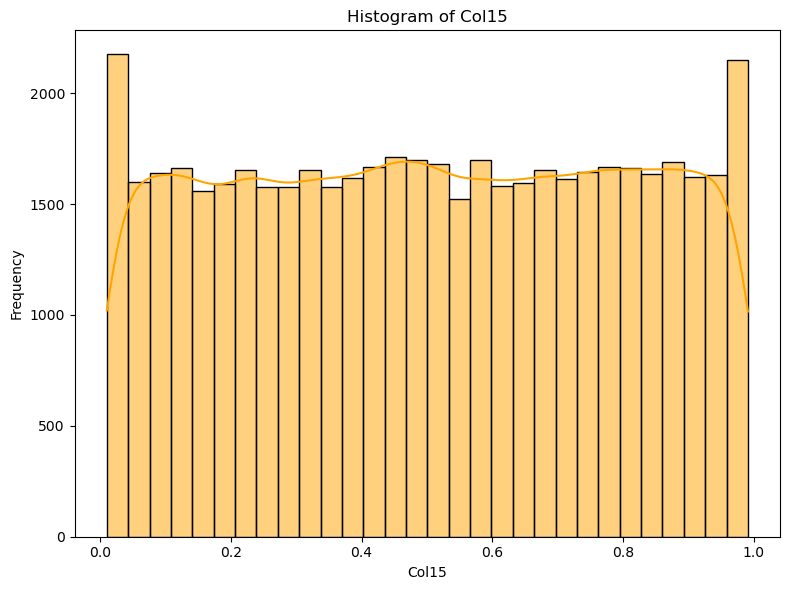

Skewness of Col15: -0.009



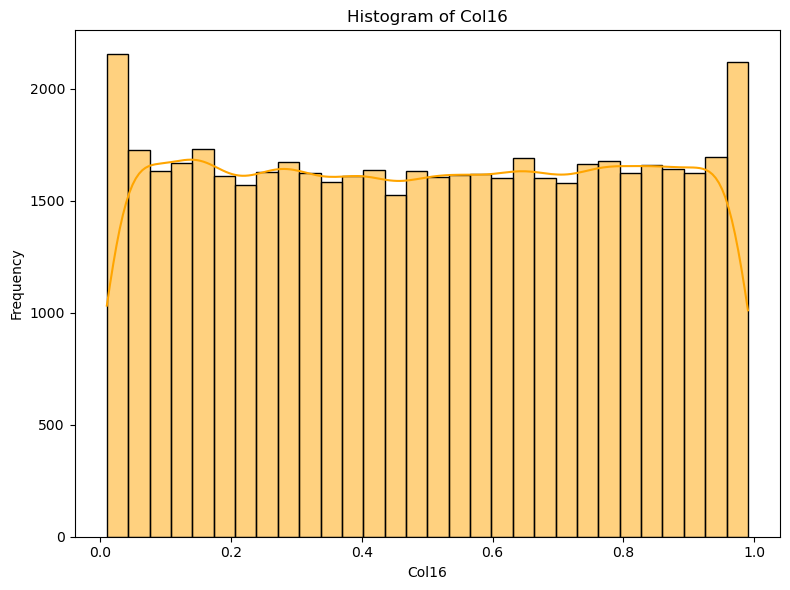

Skewness of Col16: -0.000



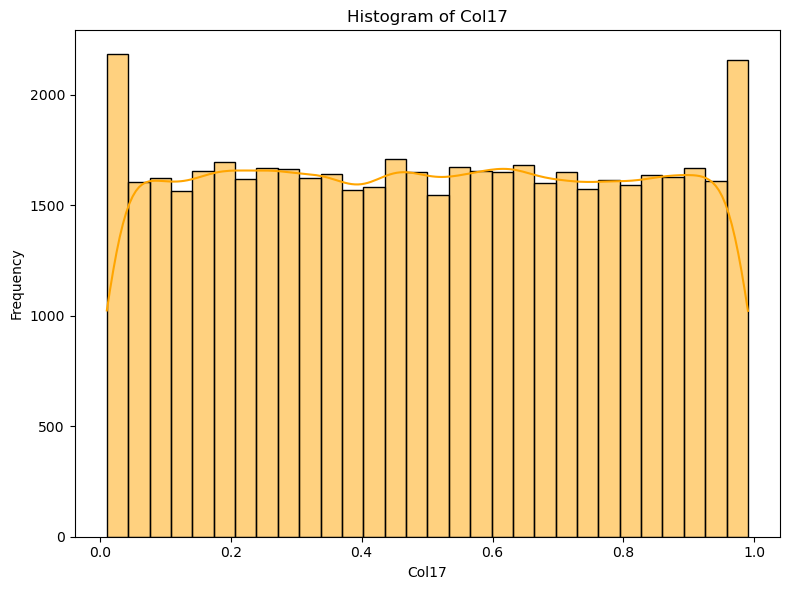

Skewness of Col17: 0.003



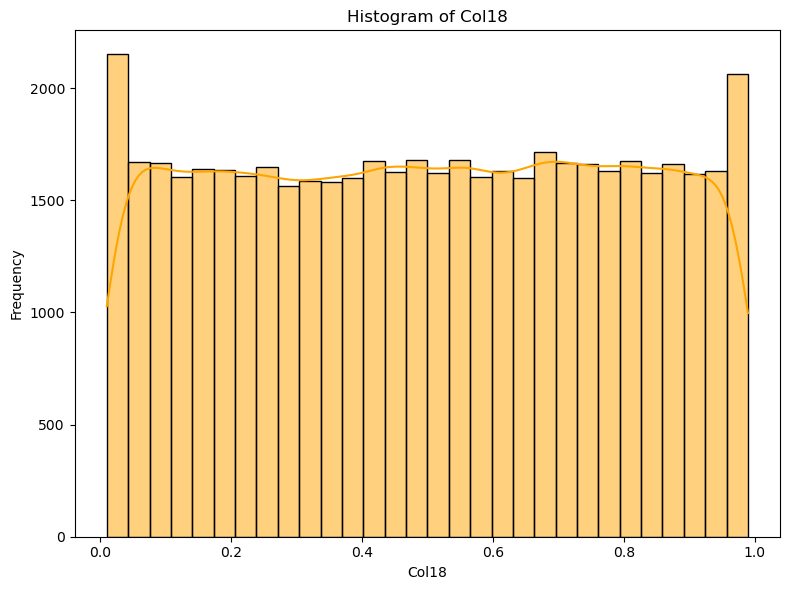

Skewness of Col18: -0.009



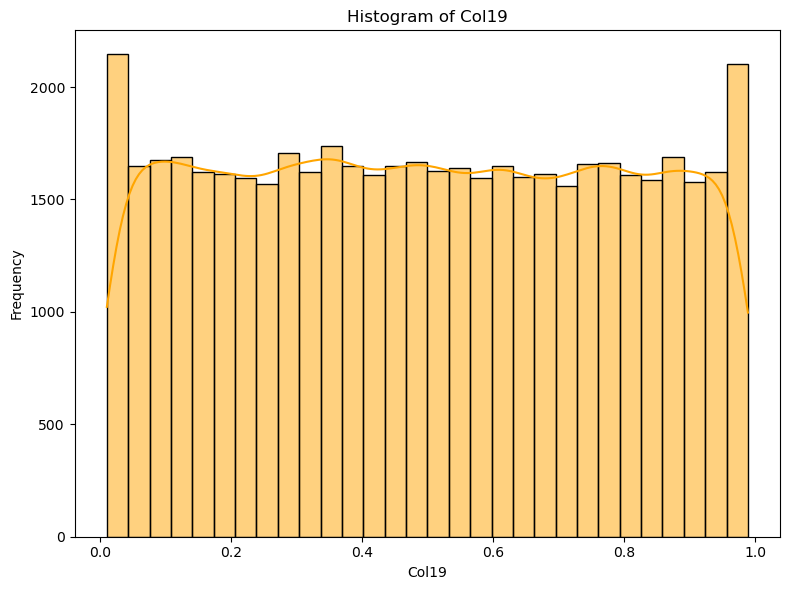

Skewness of Col19: 0.009



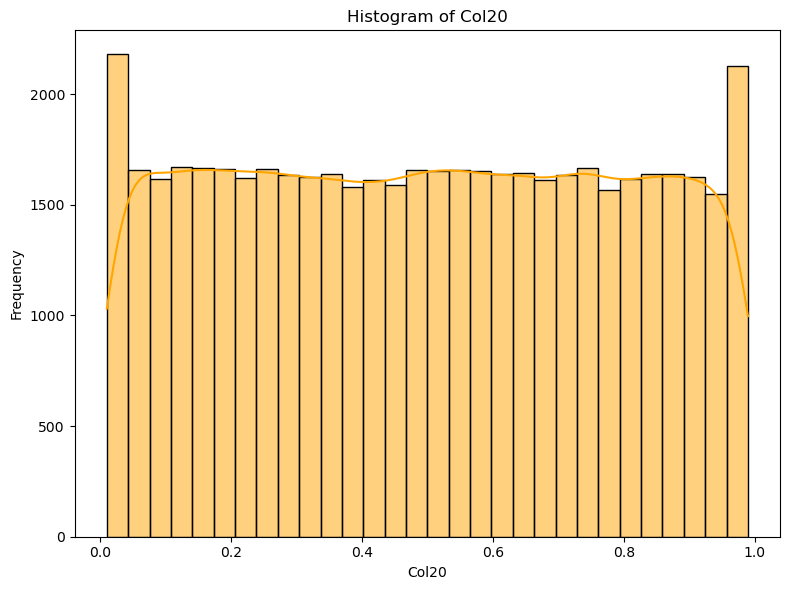

Skewness of Col20: 0.006



In [ ]:
for column in Chdata_sliced.select_dtypes(include="number").columns:
    if column == "index":
        continue
# Plot histogram
    plt.figure(figsize=(8, 6))
    sns.histplot(Chdata_sliced[column], kde=True, color='orange', bins=30)  # kde=True adds a kernel density estimate line
    plt.title(f"Histogram of {column}")
    plt.xlabel(column)
    plt.ylabel('Frequency')
    plt.tight_layout()
    plt.show()
# Print skewness for the column
    skewness = Chdata_sliced[column].skew()
    print(f"Skewness of {column}: {skewness:.3f}\n")


In [ ]:
# Loop through the numerical columns and apply log transformation for significant skewness
for column in Chdata_sliced.select_dtypes(include="number").columns:
    if column == "index":  # Skip the index column if present
        continue

    # Calculate skewness of the column
    skewness = Chdata_sliced[column].skew()

    # Check if skewness is significant (e.g., greater than 0.5)
    if skewness > 0.5:  # adjust the threshold based on your context
        print(f"Applying log transformation to {column} due to skewness of {skewness:.3f}")

        # Apply log transformation (handle zeros and negative values)
        Chdata_sliced[column] = np.log1p(Chdata_sliced[column])  # log1p is log(x + 1), safe for zero values

    else:
        print(f"No transformation needed for {column} (skewness: {skewness:.3f})")
print(Chdata_sliced.head())

No transformation needed for Col1 (skewness: 0.010)
No transformation needed for Col2 (skewness: -0.014)
No transformation needed for Col3 (skewness: 0.002)
No transformation needed for Col4 (skewness: 0.010)
No transformation needed for Col5 (skewness: -0.001)
No transformation needed for Col6 (skewness: 0.009)
No transformation needed for Col7 (skewness: -0.003)
No transformation needed for Col8 (skewness: 0.001)
No transformation needed for Col9 (skewness: 0.004)
No transformation needed for Col10 (skewness: -0.003)
No transformation needed for Col11 (skewness: 0.002)
No transformation needed for Col12 (skewness: 0.007)
No transformation needed for Col13 (skewness: -0.004)
No transformation needed for Col14 (skewness: 0.002)
No transformation needed for Col15 (skewness: -0.009)
No transformation needed for Col16 (skewness: -0.000)
No transformation needed for Col17 (skewness: 0.003)
No transformation needed for Col18 (skewness: -0.009)
No transformation needed for Col19 (skewness: 0

**Visualize histogram before and after transformation**

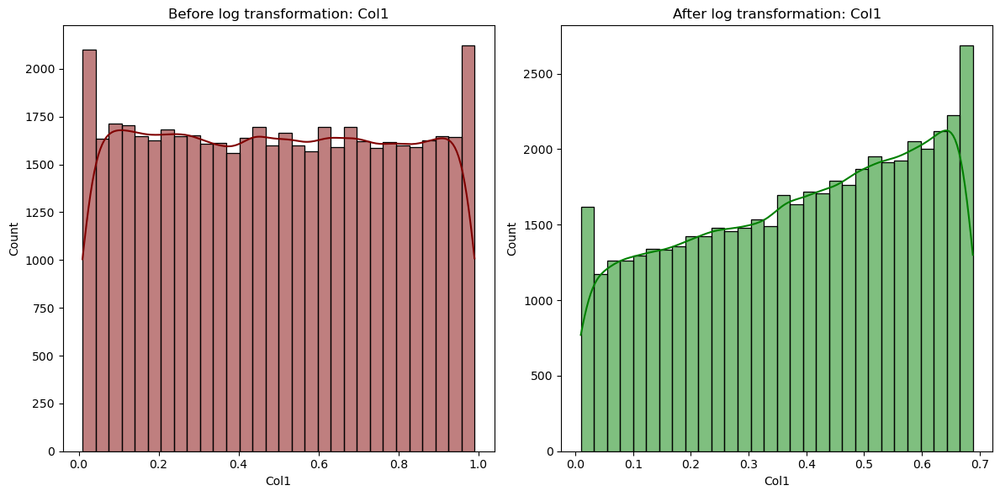

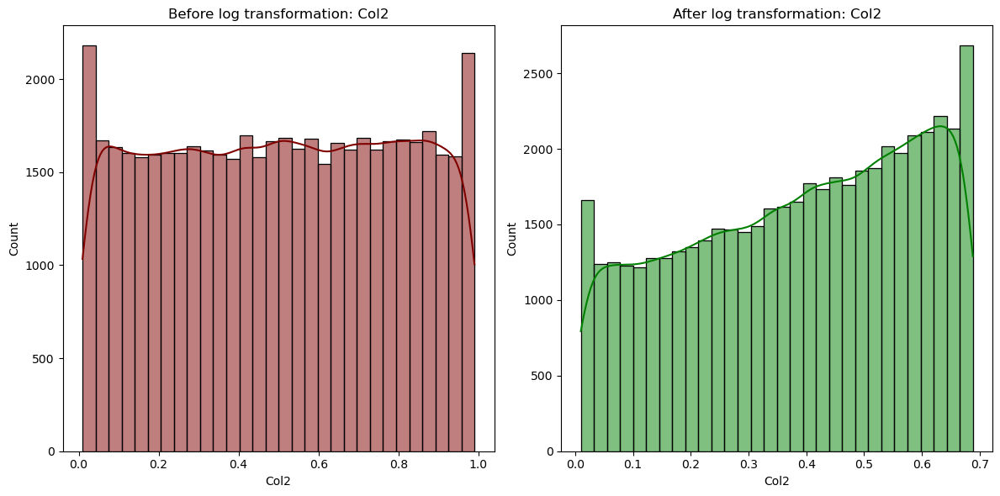

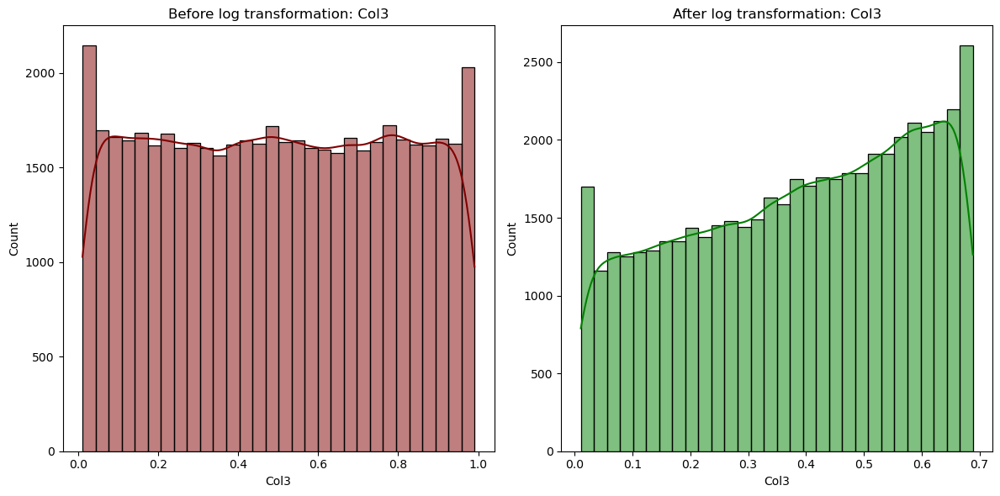

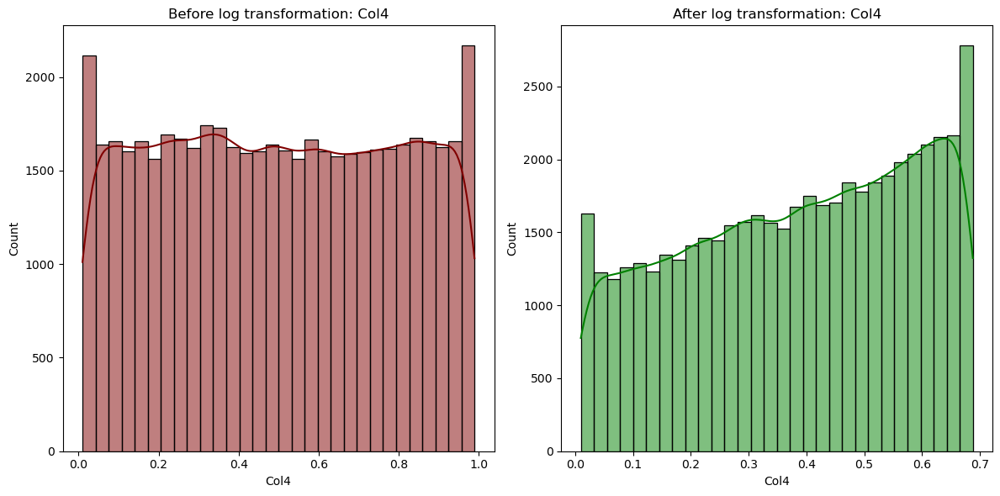

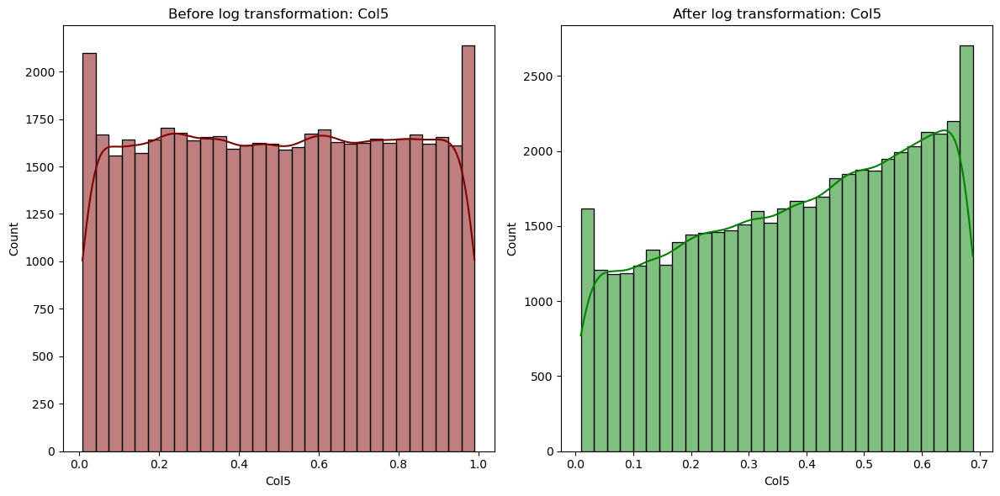

...

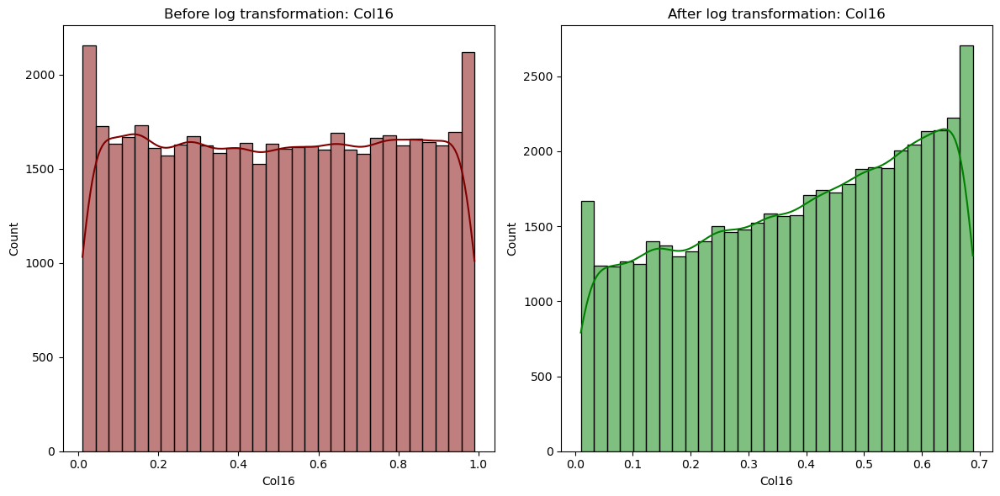

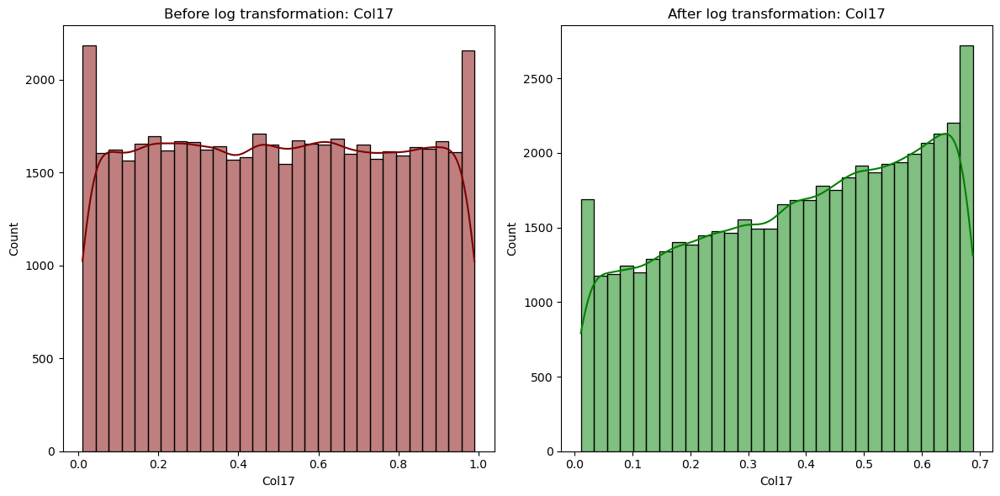

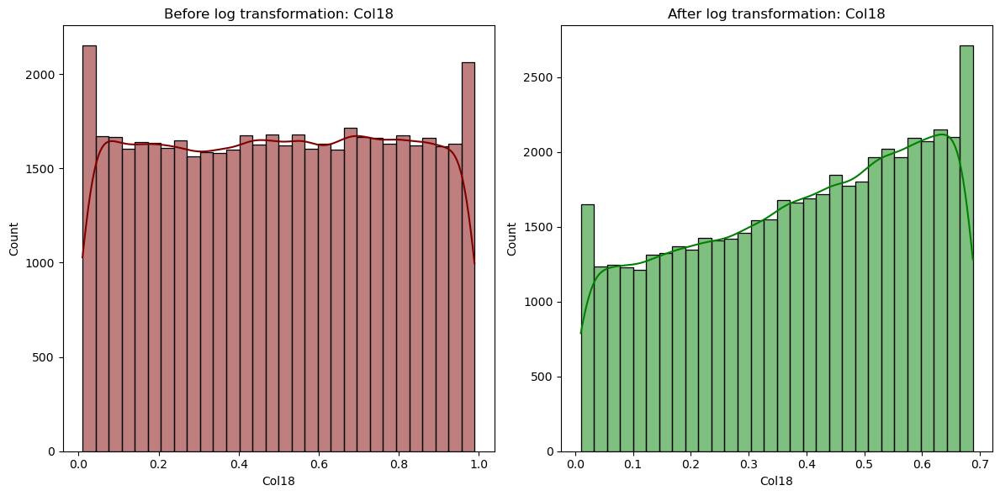

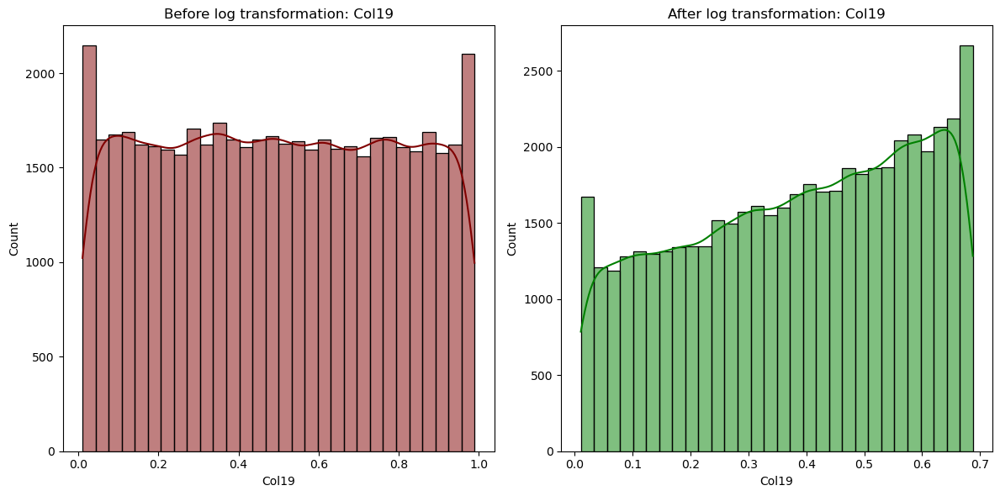

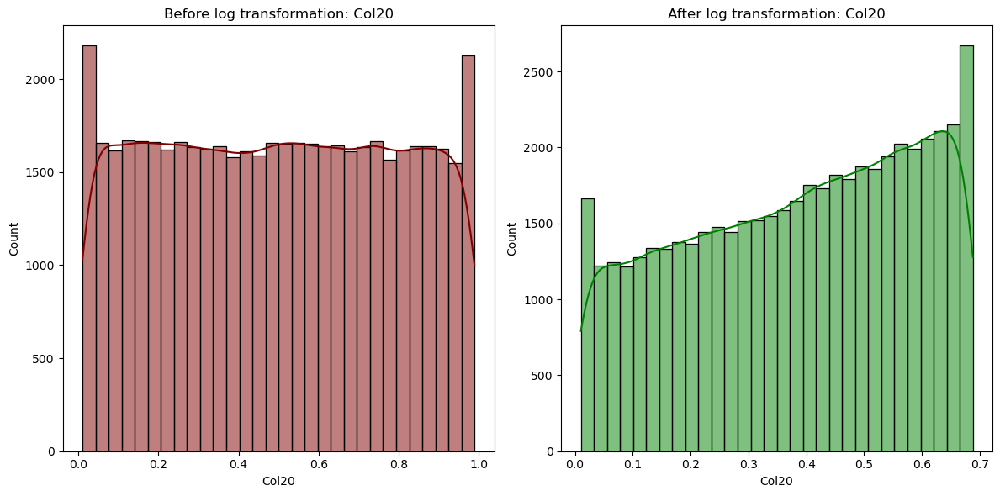

In [ ]:
# Visualize histogram before and after transformation
for column in Chdata_sliced.select_dtypes(include="number").columns:
    if column == "index":  # Skip the index column if present
        continue

    plt.figure(figsize=(12, 6))

    # Before transformation
    plt.subplot(1, 2, 1)
    sns.histplot(Chdata_sliced[column], kde=True, color='maroon', bins=30)
    plt.title(f"Before log transformation: {column}")

    # After transformation
    plt.subplot(1, 2, 2)
    sns.histplot(np.log1p(Chdata_sliced[column]), kde=True, color='green', bins=30)
    plt.title(f"After log transformation: {column}")

    plt.tight_layout()
    plt.show()


In [ ]:
Chdata_sliced.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50000 entries, 0 to 49999
Data columns (total 20 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   Col1    50000 non-null  float64
 1   Col2    50000 non-null  float64
 2   Col3    50000 non-null  float64
 3   Col4    50000 non-null  float64
 4   Col5    50000 non-null  float64
 5   Col6    50000 non-null  float64
 6   Col7    50000 non-null  float64
 7   Col8    50000 non-null  float64
 8   Col9    50000 non-null  float64
 9   Col10   50000 non-null  float64
 10  Col11   50000 non-null  float64
 11  Col12   50000 non-null  float64
 12  Col13   50000 non-null  float64
 13  Col14   50000 non-null  float64
 14  Col15   50000 non-null  float64
 15  Col16   50000 non-null  float64
 16  Col17   50000 non-null  float64
 17  Col18   50000 non-null  float64
 18  Col19   50000 non-null  float64
 19  Col20   50000 non-null  float64
dtypes: float64(20)
memory usage: 7.6 MB


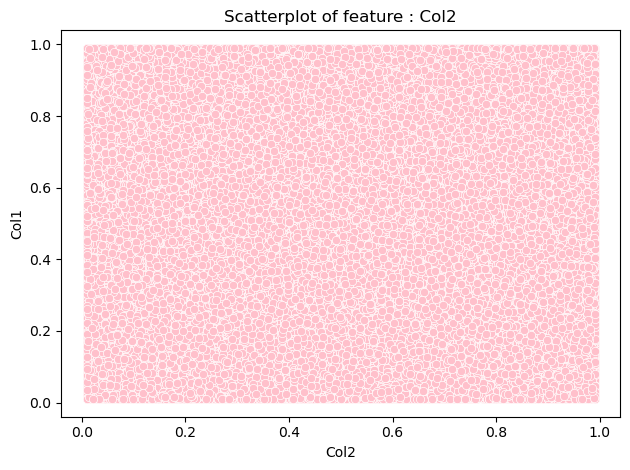

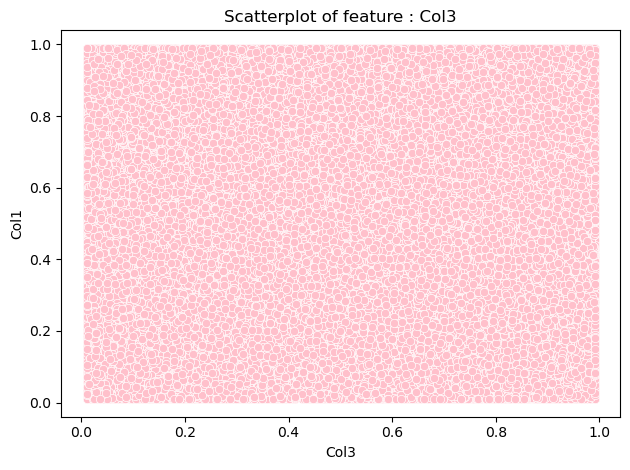

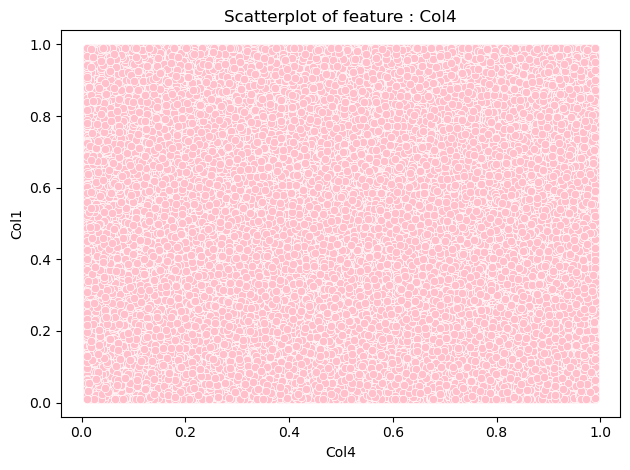

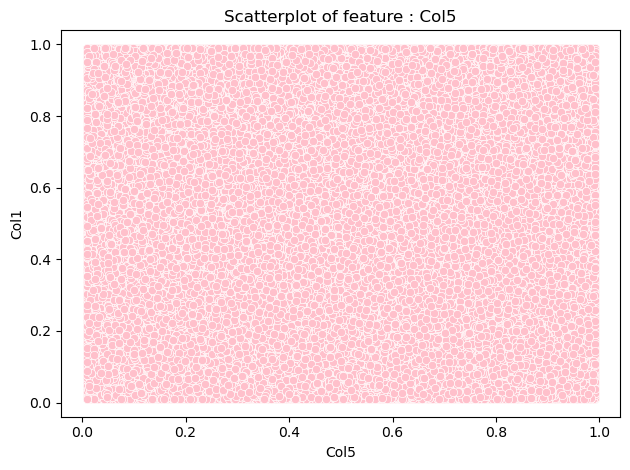

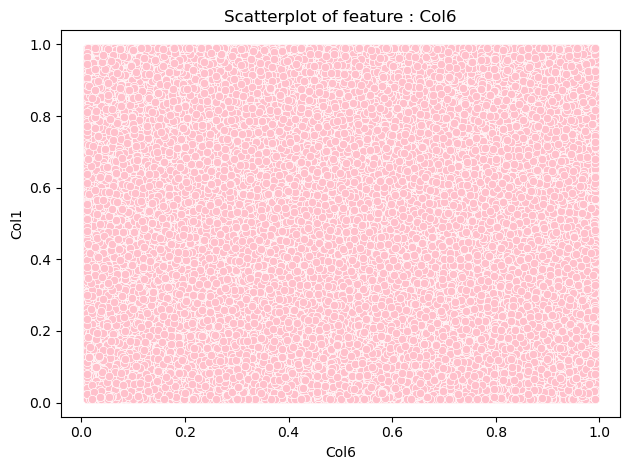

...

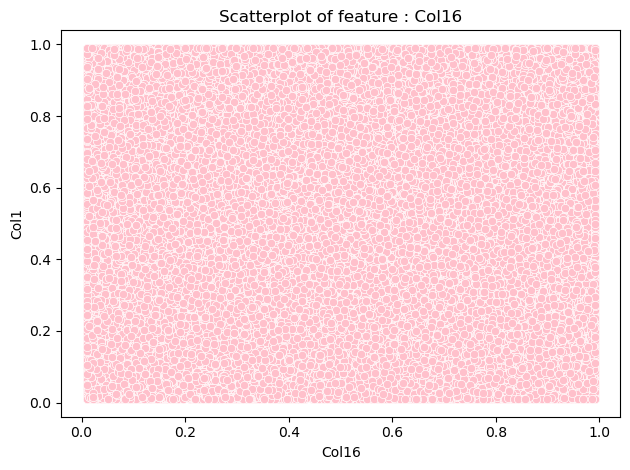

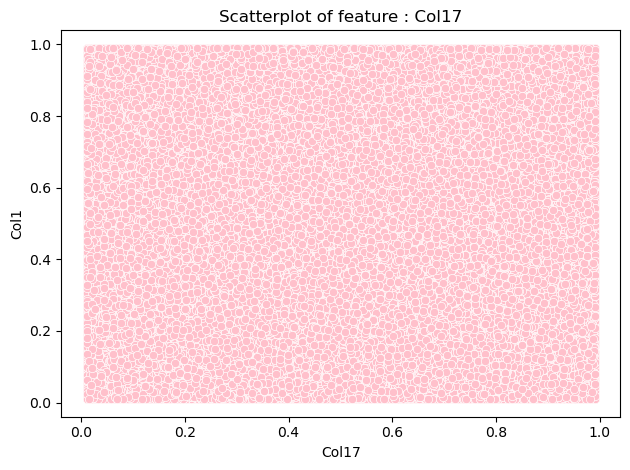

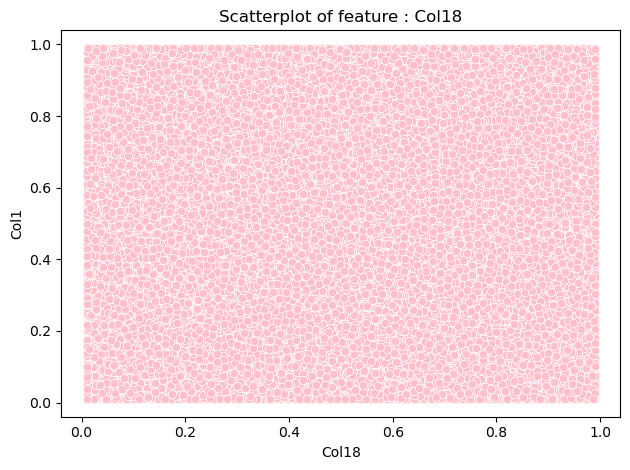

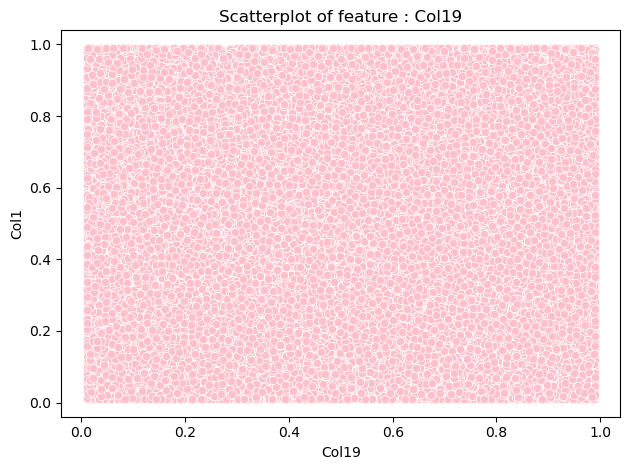

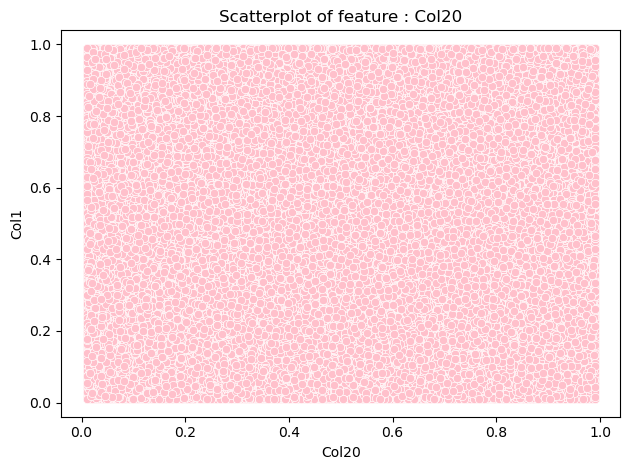

In [ ]:
# To display the relation between X values and Y, where Y is tagret value ( MeasureDesc).
for column in Chdata_sliced.columns:
    if column == "Col1":
        continue
    sns.scatterplot(data=Chdata_sliced, x=column, y="Col1",color='pink')
    plt.title(f"Scatterplot of feature : {column}")
    plt.tight_layout()
    plt.show()
    print("\n")

**7.Finding the Correlation of the Dataset**

In [ ]:
correlation_matrix = Chdata_sliced.select_dtypes(include="number").corr()
correlation_matrix

,Col1,Col2,Col3,Col4,Col5,Col6,Col7,Col8,Col9,Col10,Col11,Col12,Col13,Col14,Col15,Col16,Col17,Col18,Col19,Col20
Col1,1.000000,-0.006373,-0.004221,0.007847,0.001130,0.001511,0.001571,0.003271,0.006287,-0.002380,0.004307,-0.005963,-0.002658,-0.001501,0.002769,0.000573,-0.009025,0.004175,0.003598,0.001896
Col2,-0.006373,1.000000,0.010023,-0.002745,-0.005554,0.005679,-0.002604,0.009336,-0.006516,0.004921,-0.001574,-0.005865,-0.001918,-0.006800,0.000173,0.000619,0.002286,0.003713,-0.000270,-0.003456
Col3,-0.004221,0.010023,1.000000,0.002332,0.004497,0.011561,0.008205,0.001878,0.008336,0.000756,-0.001412,0.000936,-0.004556,0.003290,-0.004366,-0.003546,0.002405,-0.000518,0.000863,0.000645
Col4,0.007847,-0.002745,0.002332,1.000000,0.006850,-0.007172,0.006278,-0.000520,-0.009286,0.000952,-0.011096,0.000836,-0.004622,0.000118,0.002539,0.005588,-0.000388,-0.003136,0.000435,-0.000684
Col5,0.001130,-0.005554,0.004497,0.006850,1.000000,0.007237,-0.000360,0.000780,0.002436,-0.002728,0.011001,-0.007609,-0.007220,0.006388,0.003412,-0.003712,0.007902,0.002722,-0.001626,-0.000817
Col6,0.001511,0.005679,0.011561,-0.007172,0.007237,1.000000,0.001268,0.003052,-0.003363,0.005255,-0.001051,0.004564,0.005598,0.003486,0.001358,0.008062,0.003614,-0.003510,-0.008858,-0.000549
Col7,0.001571,-0.002604,0.008205,0.006278,-0.000360,0.001268,1.000000,-0.005393,0.000762,-0.001868,-0.000917,-0.002282,0.002363,0.000176,0.003746,0.001013,0.003803,-0.003387,-0.004518,-0.003131
Col8,0.003271,0.009336,0.001878,-0.000520,0.000780,0.003052,-0.005393,1.000000,-0.003824,0.000835,-0.007631,0.010929,0.001585,0.002796,0.009071,0.001363,-0.002431,0.003762,-0.000960,0.003612
Col9,0.006287,-0.006516,0.008336,-0.009286,0.002436,-0.003363,0.000762,-0.003824,1.000000,0.007265,0.003965,-0.011262,0.002780,0.004030,0.002675,-0.001194,-0.000565,0.002467,-0.000037,-0.003759
Col10,-0.002380,0.004921,0.000756,0.000952,-0.002728,0.005255,-0.001868,0.000835,0.007265,1.000000,-0.004012,-0.002472,0.009060,-0.004119,0.004676,0.002062,-0.002500,0.002106,0.003560,0.005819


           Col1      Col2      Col3      Col4      Col5      Col6      Col7  \
Col1   1.000000 -0.006373 -0.004221  0.007847  0.001130  0.001511  0.001571   
Col2  -0.006373  1.000000  0.010023 -0.002745 -0.005554  0.005679 -0.002604   
Col3  -0.004221  0.010023  1.000000  0.002332  0.004497  0.011561  0.008205   
Col4   0.007847 -0.002745  0.002332  1.000000  0.006850 -0.007172  0.006278   
Col5   0.001130 -0.005554  0.004497  0.006850  1.000000  0.007237 -0.000360   
Col6   0.001511  0.005679  0.011561 -0.007172  0.007237  1.000000  0.001268   
Col7   0.001571 -0.002604  0.008205  0.006278 -0.000360  0.001268  1.000000   
Col8   0.003271  0.009336  0.001878 -0.000520  0.000780  0.003052 -0.005393   
Col9   0.006287 -0.006516  0.008336 -0.009286  0.002436 -0.003363  0.000762   
Col10 -0.002380  0.004921  0.000756  0.000952 -0.002728  0.005255 -0.001868   
Col11  0.004307 -0.001574 -0.001412 -0.011096  0.011001 -0.001051 -0.000917   
Col12 -0.005963 -0.005865  0.000936  0.000836 -0.007

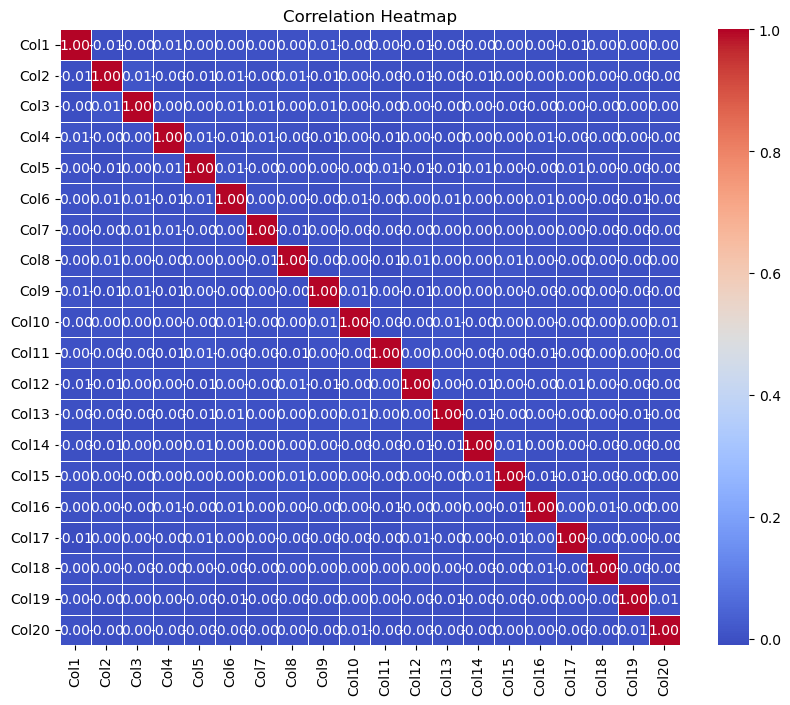

In [ ]:
correlation_matrix = Chdata_sliced.corr()  # Compute correlation matrix
print(correlation_matrix)
#heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f', linewidths=0.5)
plt.title('Correlation Heatmap')
plt.show()

**8.Data Encoding**

In [ ]:
print(Chdata_sliced)

           Col1      Col2      Col3      Col4      Col5      Col6      Col7  \
0      0.095644  0.485894  0.563608  0.099474  0.886067  0.895797  0.297351   
1      0.026587  0.190246  0.624189  0.020517  0.055785  0.374656  0.332223   
2      0.044136  0.698581  0.756068  0.419360  0.081010  0.761673  0.903186   
3      0.100795  0.183499  0.647173  0.876153  0.951901  0.504132  0.638563   
4      0.458765  0.946854  0.871038  0.171558  0.709695  0.509348  0.841983   
...         ...       ...       ...       ...       ...       ...       ...   
49995  0.262161  0.216562  0.044267  0.610461  0.259507  0.018103  0.819991   
49996  0.408846  0.883924  0.935950  0.358129  0.851459  0.888515  0.785609   
49997  0.564840  0.798536  0.520863  0.592659  0.078141  0.041714  0.387057   
49998  0.746673  0.611804  0.067693  0.184549  0.430772  0.600022  0.428722   
49999  0.488155  0.943902  0.526536  0.571539  0.037143  0.893261  0.158176   

           Col8      Col9     Col10     Col11     C

In [ ]:
###Adding all object valued columns in one variable to make it easier to navigate.
columns = ['Col1', 'Col2', 'Col3', 'Col4', 'Col5', 'Col6', 'Col7', 'Col8', 'Col9', 'Col10',
           'Col11', 'Col12', 'Col13', 'Col14', 'Col15', 'Col16', 'Col17', 'Col18', 'Col19', 'Col20']# define categorical columns

Explanation: pd.get_dummies() automatically creates new columns for each unique category within a categorical variable.For each category, a binary value (0 or 1) is assigned to indicate the presence or absence of that category in the original data.

In [ ]:
## Merged the target variable from the Ctobdata and encoded_tdf to df_concat.
encoded_Cds = pd.get_dummies(Chdata_sliced['Col1'])
df_concat = pd.concat([encoded_Cds, Chdata_sliced['Col2']], axis=1)
df_concat


,0.009432,0.009432,0.009434,0.009468,0.009483,0.009489,0.00951,0.009513,0.009586,0.009589,...,0.99026,0.99027,0.990315,0.990319,0.990337,0.990342,0.990354,0.990358,0.990358,Col2
0,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,0.485894
1,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,0.190246
2,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,0.698581
3,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,0.183499
4,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,0.946854
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49995,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,0.216562
49996,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,0.883924
49997,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,0.798536
49998,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,0.611804


In [ ]:
###A routine check if there is null value after merging the column.
print(df_concat.isnull().sum())

0.009432    0
0.009432    0
0.009434    0
0.009468    0
0.009483    0
           ..
0.990342    0
0.990354    0
0.990358    0
0.990358    0
Col2        0
Length: 49003, dtype: int64


In [ ]:
#since data contain both int and float
# Fill NaN values with a placeholder (e.g., 'Unknown') and convert the column to string type
df_concat['Col2'] = df_concat['Col2'].fillna('Unknown').astype(str)

# Create an instance of LabelEncoder
le = LabelEncoder()

# Apply Label Encoding to 'Col2'
df_concat['Col2'] = le.fit_transform(df_concat['Col2'])

# Display the first few rows of the encoded column
print(df_concat['Col2'].head())


0    23594
1     9017
2    34266
3     8674
4    46884
Name: Col2, dtype: int32


In [ ]:
# Create an instance of LabelEncoder
le = LabelEncoder()
df_concat['Col2'] = le.fit_transform(df_concat['Col2'])

# Display the first few rows of the original and encoded columns
print(df_concat['Col2'])

0        23594
1         9017
2        34266
3         8674
4        46884
         ...  
49995    10293
49996    43732
49997    39356
49998    29994
49999    46741
Name: Col2, Length: 50000, dtype: int64


**9.Feature selection**

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.feature_selection import SelectKBest, f_regression
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

In [ ]:
# Define feature matrix and target variable
X = df_concat.drop(columns=['Col2'])  # Drop the target column to get only features
y = df_concat['Col2']

# Split data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

print("X_train\n",X_train.shape, "\nX_test",X_test.shape, "\ny_train",y_train.shape,"\n y_test" ,y_test.shape )

X_train
 (40000, 49002) 
X_test (10000, 49002) 
y_train (40000,) 
 y_test (10000,)


In [ ]:
# Select top K features based on F-test
k = 15  # You can adjust the number of features you want to select
selector = SelectKBest(score_func=f_regression, k=k)
X_train_selected = selector.fit_transform(X_train, y_train)
X_test_selected = selector.transform(X_test)

# Get selected feature names
selected_features = X.columns[selector.get_support()]
print("Selected Features:", selected_features)

Selected Features: Index([0.9552785165820408, 0.9580998803015973, 0.9593728299696783,
       0.9606285342991333, 0.9620681808786771, 0.9641242922211529,
        0.976230712257958, 0.9767346967294703, 0.9779440706964839,
       0.9785881576661978, 0.9794311660014581, 0.9817717689128754,
       0.9853408727041638, 0.9869182386486233,  0.989807668311333],
      dtype='object')


**10.Standardised Feature**

In [ ]:
from sklearn.preprocessing import MaxAbsScaler
# Create a MaxAbsScaler object
scaler = MaxAbsScaler()
# Apply the scaling to the selected features
X_train_scaled = scaler.fit_transform(X_train_selected)
X_test_scaled = scaler.transform(X_test_selected)
print(X_train_scaled.shape)


(40000, 15)


**Principal Component Analysis (PCA)**

In [ ]:
# Apply PCA to retain 95% variance
pca = PCA(n_components=10)
X_train_pca = pca.fit_transform(X_train_scaled)
X_test_pca = pca.transform(X_test_scaled)

# Check the number of components
print("Number of PCA components:", X_train_pca.shape[1], X_test_pca.shape[1])

Number of PCA components: 10 10


**11.ML Modeling**

In [ ]:
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.svm import SVR
from sklearn.metrics import classification_report
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
import pandas as pd

# Initialize models
models = {
    'Linear Regression': LinearRegression(),
    'Decision Tree': DecisionTreeRegressor(random_state=42),
    'Random Forest': RandomForestRegressor(random_state=42)
}

# Train each model and store predictions
predictions = {}
for model_name, model in models.items():
    model.fit(X_train_pca, y_train)  # Training on the selected features
    predictions[model_name] = model.predict(X_test_pca)  # Store predictions for later evaluation

In [ ]:
###Use Regression Models
###Replace the classification models with regression models. Here are some common regression models:
# Example with regression models
models = {
    'Linear Regression': LinearRegression(),
    'Decision Tree': DecisionTreeRegressor(random_state=42),
    'Random Forest': RandomForestRegressor(random_state=42),
    'Support Vector Regressor': SVR()
}

In [ ]:
import numpy as np
from sklearn.decomposition import PCA
from sklearn.linear_model import SGDRegressor
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split
from scipy.sparse import csr_matrix

# Split your dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Convert the data to sparse format if it's sparse (i.e., contains many zeros)
X_train_sparse = csr_matrix(X_train)
X_test_sparse = csr_matrix(X_test)

# Reduce the number of features using PCA
n_components = 10  # Try even lower components for further memory reduction
pca = PCA(n_components=n_components)

# Fit PCA and transform the training data
X_train_reduced = pca.fit_transform(X_train_sparse)

# Transform the test data using the same PCA object
X_test_reduced = pca.transform(X_test_sparse)

# Convert the reduced data back to sparse format
X_train_sparse = csr_matrix(X_train_reduced)
X_test_sparse = csr_matrix(X_test_reduced)

# Initialize the SGD Regressor
sgd_model = SGDRegressor(max_iter=1000, tol=1e-3)

# Train the model using the reduced data
sgd_model.fit(X_train_sparse, y_train)

# Predict on the test set
y_pred = sgd_model.predict(X_test_sparse)

# Evaluate the model using Mean Squared Error
mse = mean_squared_error(y_test, y_pred)
print(f"Mean Squared Error: {mse}")


Mean Squared Error: 207468147.19379464


In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.linear_model import LinearRegression, SGDRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.svm import SVR
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from sklearn.pipeline import make_pipeline
from sklearn.decomposition import IncrementalPCA

# Assuming `df` is your dataframe and `target_column` is the column you want to predict
# Define the feature columns (X) and target column (y)
X = Chdata_sliced.drop(columns=['Col20'])  # Replace 'target_column' with your actual target column name
y = Chdata_sliced['Col20']  # Replace with your target column

# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Scale the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Apply PCA for dimensionality reduction
n_components = 19  # Set n_components to the number of features (since you have 19 features)
pca = PCA(n_components=n_components)
X_train_reduced = pca.fit_transform(X_train_scaled)
X_test_reduced = pca.transform(X_test_scaled)

# Initialize the models
models = {
    'Linear Regression': LinearRegression(),
    'Decision Tree': DecisionTreeRegressor(),
    'Random Forest': RandomForestRegressor(n_jobs=-1),  # Use all cores for parallel processing
    'Support Vector Regressor': SVR(),
    'SGD Regressor': make_pipeline(StandardScaler(), SGDRegressor(max_iter=1000, tol=1e-3))  # Using incremental approach
}

# Evaluate models using regression metrics
results = []

for model_name, model in models.items():
    try:
        model.fit(X_train_reduced, y_train)
        y_pred = model.predict(X_test_reduced)

        mse = mean_squared_error(y_test, y_pred)
        rmse = np.sqrt(mse)
        mae = mean_absolute_error(y_test, y_pred)
        r2 = r2_score(y_test, y_pred)

        results.append({
            'Model': model_name,
            'MSE': mse,
            'RMSE': rmse,
            'MAE': mae,
            'R2 Score': r2
        })
    except MemoryError:
        print(f"MemoryError occurred with model: {model_name}")

# Convert results to a DataFrame for easy viewing
results_Chdata_sliced = pd.DataFrame(results)
print("Evaluation Metrics for Each Model:")
print(results_Chdata_sliced)


Evaluation Metrics for Each Model:
                      Model       MSE      RMSE       MAE  R2 Score
0         Linear Regression  0.084513  0.290712  0.252302 -0.000338
1             Decision Tree  0.171626  0.414277  0.338123 -1.031442
2             Random Forest  0.085652  0.292664  0.253512 -0.013822
3  Support Vector Regressor  0.097268  0.311879  0.265840 -0.151313
4             SGD Regressor  0.084826  0.291249  0.252659 -0.004040


**Interpretation**

The **Linear Regression** and **Random Forest** models perform similarly, with relatively low MSE and RMSE, indicating decent prediction accuracy, but their poor R² scores suggest they don’t capture much of the variance in the data. The **Decision Tree** and **Support Vector Regressor (SVR)** models perform worse, with higher error metrics and negative R² scores, indicating they are not effective for this task. The **SGD Regressor** has results close to Linear Regression but with a slightly worse R² score. Overall, while **Linear Regression** and **Random Forest** show the best performance based on error metrics, all models struggle to explain the variability in the data, suggesting a need for further feature engineering or model refinement.

In [ ]:
# Import necessary libraries
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.svm import SVR
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import numpy as np

# Assuming X and y are your feature matrix and target vector
# Replace X and y with your actual data
# Example: X = df.drop(columns='target'), y = df['target']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Define the models
models = {
    'Linear Regression': LinearRegression(),
    'Decision Tree Regressor': DecisionTreeRegressor(random_state=42),
    'Random Forest Regressor': RandomForestRegressor(random_state=42),
    'Gradient Boosting Regressor': GradientBoostingRegressor(random_state=42),
    'Support Vector Regressor': SVR()
}

# Loop through models, train, predict, and display regression metrics
for model_name, model in models.items():
    # Train the model
    model.fit(X_train, y_train)
      # Predict on the test set
    y_pred = model.predict(X_test)

    # Calculate regression metrics
    mse = mean_squared_error(y_test, y_pred)
    rmse = np.sqrt(mse)
    mae = mean_absolute_error(y_test, y_pred)
    r2 = r2_score(y_test, y_pred)

    # Display results
    print(f"\nMetrics for {model_name}:")
    print(f"MSE: {mse}")
    print(f"RMSE: {rmse}")
    print(f"MAE: {mae}")
    print(f"R² Score: {r2}")


Metrics for Linear Regression:
MSE: 0.08451320378068596
RMSE: 0.29071154738105254
MAE: 0.25230202263835455
R² Score: -0.0003382154404993898

Metrics for Decision Tree Regressor:
MSE: 0.16960697705067182
RMSE: 0.4118336764407105
MAE: 0.33549685273227
R² Score: -1.0075483256960687

Metrics for Random Forest Regressor:
MSE: 0.08580869856445897
RMSE: 0.2929312181459309
MAE: 0.2536135930688196
R² Score: -0.015672303868562443

Metrics for Gradient Boosting Regressor:
MSE: 0.0847856168325012
RMSE: 0.2911796985239548
MAE: 0.252454458079944
R² Score: -0.003562625046632961

Metrics for Support Vector Regressor:
MSE: 0.09727183004361943
RMSE: 0.3118843215739121
MAE: 0.2658434988331748
R² Score: -0.1513553447929179


## Understanding the Metrics: ##
- **MSE** and **RMSE** measure prediction accuracy, with lower values indicating better performance. All models have relatively low MSE and RMSE, suggesting moderate accuracy.
- **MAE** shows the average prediction error in the same units as the target. Lower MAE is better, and all models have reasonable errors.
- **R² Score** indicates how much variance the model explains. Negative values (as seen in all models) mean the model performs poorly and is worse than just predicting the mean.
In short, while the models have low prediction errors, none of them explain much of the data's variability, as reflected by their negative R² scores.
# Interpretation #
**The models show varying levels of performance:**
- **Linear Regression**: Lowest errors (MSE, RMSE, MAE) but very poor **R²** (close to 0), indicating it doesn't explain much of the variance.
- **Random Forest**: Similar performance to Linear Regression, with low error metrics but a negative **R²**, showing limited explanatory power.
- **Decision Tree**: Higher errors (MSE, RMSE, MAE) and a more negative **R²**, indicating worse performance than the other models.
- **Support Vector Regressor (SVR)**: Highest errors and the lowest **R²** score, making it the least effective model.
- **Overall**: All models have negative **R²** scores, meaning none of them capture the data well.
# From the above metrics: #
 **Perfect Scores**  
- **Definition**: Perfect scores would indicate that a model makes no error in prediction and fully explains the variability in the target variable (i.e., an **R²** score of 1 and **MSE** or **RMSE** equal to 0).
- **Explanation**:  
  - **None of the models** have perfect scores.
  - The **R²** scores for all models are negative, meaning none of the models explain much of the variance in the target variable.
  - This implies that even the best-performing models are not capturing the underlying patterns effectively.
 **Extremely High Scores**  
- **Definition**: Extremely high scores would indicate models with high predictive accuracy and excellent performance across all metrics.
- **Explanation**:  
  - **None of the models** have "extremely high" scores, as seen in their **MSE**, **RMSE**, **MAE**, and **R²** values.
  - The **R²** scores for all models are negative, implying that the models are underperforming. Ideally, **R²** should be positive (closer to 1) for high-performing models.
  - Models like **SVR** and **Decision Tree** have particularly high **MSE** and **RMSE**, indicating poor accuracy, making them far from "extremely high" performance.
 **Lower Performance**  
- **Definition**: Lower performance refers to models with high prediction errors (MSE, RMSE, MAE) and poor explanatory power (low **R²**).
- **Explanation**:  
  - **SVR** has the highest **MSE** (0.0957) and **RMSE** (0.3093) among all models, along with the lowest **R²** score (-0.145). This suggests that **SVR** has the poorest performance overall.
  - **Decision Tree** also shows high errors (**MSE** = 0.1718, **RMSE** = 0.4145) and a very negative **R²** score (-1.056), indicating it's not fitting the data well.
  - Even **Random Forest** and **Linear Regression**, which have relatively lower error metrics, still fail to explain much of the variance, as indicated by their negative **R²** scores.
## Conclusion ##
All models perform poorly in explaining the target variable, as indicated by their negative R² scores. Linear Regression and Random Forest are the best-performing models, but none of the models are suitable for capturing the data effectively.